# Analysis notebook for GPI 2.0 APLC solutions 

In [1]:
from mpl_toolkits.axes_grid1 import make_axes_locatable
from scipy.ndimage import zoom, map_coordinates

In [2]:
from survey import DesignParameterSurvey
import numpy as np
import time
from hcipy import *
from por_aplc_analysis import create_coronagraph
from astropy.io import fits
import astropy.units as u
import matplotlib.pyplot as plt
from matplotlib import gridspec
%matplotlib inline
# %pylab inline 
import gpipsfs
import webbpsf
import hcipy
webbpsf.setup_logging('none')
path = '/home/mmnguyen/Research/STScI/GPI2'

ModuleNotFoundError: No module named 'survey'

Convinience functions:

In [1]:
np.linspace(-0.4 / 2, 0.4 / 2, 3) + 1

NameError: name 'np' is not defined

# Specify survey(s) and solution(s) for analysis
Provide the name of the survey(s) and particular solution(s) you would like to perform analysis on:

In [3]:
import asdf

In [4]:
#survey_name = 'gpi_2_aplc_c8_iwa34_fpmK1_N0512_telserv3'
survey_name = 'gpi_aplc_2_test_N0300_telserv3'
#solution_filename = '0_GPI_N512_FPM347M0512_IWA0340_OWA02200_C8_BW20_Nlam3_LS_ID04_ov_ODp01__ls_truts_no_tab.fits'
solution_filename = '0_GPI_N300_FPM280M0300_IWA0500_OWA02200_C7_BW20_Nlam5_LS_ID04_ov_ODp01__ls_truts_no_tab.fits'
solution = path+'/Surveys/'+survey_name+'/solutions/'+solution_filename #solution path

In [5]:
soln = asdf.open(solution)
parameters = soln.tree['parameters']
file_organization = soln.tree['file_organization']
apodizer = soln.tree['apodizer']

pup_fname = parameters['pupil']['filename']
fpm_radius = parameters['focal_plane_mask']['radius']
fpm_num_pix = parameters['focal_plane_mask']['num_pix']
fpm_grayscale = parameters['focal_plane_mask']['grayscale']
ls_fname = parameters['lyot_stop']['filename']
ls_alignment_tolerance = parameters['lyot_stop']['alignment_tolerance']
ls_num_stops = parameters['lyot_stop']['num_lyot_stops']

Initiate coronagraph object:

In [6]:
parameters['lyot_stop']['filename'] = '/home/mmnguyen/Research/STScI/GPI2/Surveys/gpi_aplc_2_test_N0300_telserv3/inputs/LS_GPI_080m12_04_ovsamp01_struts_no_tabs_N0300.fits'

In [7]:
parameters['pupil']['filename'] = '/home/mmnguyen/Research/STScI/GPI2/Surveys/gpi_aplc_2_test_N0300_telserv3/inputs/Primary_GPI_SpidTrue_N0300.fits'

In [8]:
pupil, apodizer, focal_plane_mask, lyot_stops, parameters, file_organization = create_coronagraph(solution)

In [9]:
#Extract some information for later
npix = parameters['pupil']['N']
iwa = parameters['image']['iwa']
owa = parameters['image']['owa']
bandwidth = parameters['image']['bandwidth']
radius_fpm = parameters['focal_plane_mask']['radius']
contrast = parameters['image']['contrast']
ls_alignment_tolerance = parameters['lyot_stop']['alignment_tolerance']
ls_fname = parameters['lyot_stop']['filename']
pupil_fname = parameters['pupil']['filename']
lyot_stop = lyot_stops[0]
lyot_name = (ls_fname.split("_", 4))
lyot_name = 'GPI Lyot '+lyot_name[2]+'_'+lyot_name[3]

In [10]:
import gpipsfs
fpm_h = gpipsfs.GPI_FPM('H').sample(npix=1024)

In [11]:
def calc_psf(aperture, bw, ref_wave, n_wave, lyot_stop, fpm):
    broadband_psf = 0
    broadband_img_ref = 0
    
    broadband_psf_ab = 0
    broadband_img_ref_ab = 0
    flux_fudge_aperture = aperture.ravel()
    
    for pp in range(0, n_wave):
        
        #defining wavelength range
        wave_tmp = ref_wave * (1 - bw / 2 + bw / n_wave * pp)
        
        # UNOCCULTED PSF
        # Note: wf = psi_A
        wf = hcipy.Wavefront(flux_fudge_aperture, wave_tmp)
        
        pupil_grid = hcipy.make_pupil_grid(300)
        #focal_grid = make_focal_grid(8, owa * 1.2)   
        focal_grid = hcipy.make_focal_grid(q=5, num_airy=300/10)
        prop = hcipy.FraunhoferPropagator(pupil.grid, focal_grid)
        
        coro = LyotCoronagraph(pupil.grid, fpm, lyot_stop)
        
        img_ref = prop(hcipy.Wavefront(flux_fudge_aperture * lyot_stop)).intensity
        
        img = prop(coro(wf)).intensity
        
        #img_ref = prop.forward(wf).intensity
        broadband_img_ref += img_ref
        
        
        # OCCULTED PSF
        wf = hcipy.Wavefront(flux_fudge_aperture, wave_tmp)
        
#         wf = self.aberration(wf)
#         wf = self.dm(wf)
#         wf = self.ttm(wf)
#         lyot_plane = self.coro.forward(wf)
#         post_lyot_mask = lyot_stop(lyot_plane)
#         img = self.prop_norm(post_lyot_mask).intensity

        psi_B = prop.forward(wf)
        psi_B.electric_field *= (1 - fpm)
        
        psi_C = prop.backward(psi_B)
        psi_C.electric_field = wf.electric_field - psi_C.electric_field
        psi_C.electric_field *= lyot_stop.ravel()
        
        #focal_grid_science = make_focal_grid(8, owa * 1.2)   
        focal_grid_science = hcipy.make_focal_grid(q=5, num_airy=300/10)
        prop_science = hcipy.FraunhoferPropagator(pupil.grid, focal_grid_science)
        psi_D = prop_science.forward(psi_C)
        
        #broadband_psf += img
        #broadband_psf += psi_D.intensity
        broadband_psf += img
        
        
        # UNOCCULTED PSF WITH ABERRATION INCLUDED
        wf = hcipy.Wavefront(flux_fudge_aperture, wave_tmp)
        
        aberration = make_aberration(1, 5, hcipy.make_pupil_grid(300), 1)
        
        #with phase screens, propagate the aberration through as an "apodizer" object (even though it's obviously
        # not an apodizer)
        #aberration = hcipy.make_apodizer(fits.getdata('PHASE_SCREENS.FITS'))
        # the phase screen data is the RESIDUALS from running the AO system in closed loop 
        wf_ab = aberration.forward(wf)
        
        img_ref_ab = prop.forward(wf_ab).intensity
        broadband_img_ref_ab += img_ref_ab
        
        coro = LyotCoronagraph(pupil.grid, fpm, lyot_stop)
        
        img_ref_ab = prop(aberration.forward(hcipy.Wavefront(flux_fudge_aperture * lyot_stop))).intensity
        
        img_ab = prop(coro(wf_ab)).intensity
        
        
        # OCCULTED PSF WITH ABERRATION INCLUDED
        wf = hcipy.Wavefront(flux_fudge_aperture, wave_tmp)
        
        psi_A_ab = aberration.forward(wf)
        
        psi_B_ab = prop.forward(psi_A_ab)
        psi_B_ab.electric_field *= (1 - fpm)
        
        psi_C_ab = prop.backward(psi_B_ab)
        psi_C_ab.electric_field = psi_A_ab.electric_field - psi_C_ab.electric_field
        psi_C_ab.electric_field *= lyot_stop.ravel()
        
        #focal_grid_science = make_focal_grid(8, owa * 1.2)   
        focal_grid_science_ab = hcipy.make_focal_grid(q=5, num_airy=300/10)
        prop_science_ab = hcipy.FraunhoferPropagator(pupil.grid, focal_grid_science_ab)
        psi_D_ab = prop_science.forward(psi_C_ab)
        
        #broadband_psf += img
        #broadband_psf_ab += psi_D_ab.intensity
        broadband_psf_ab += img_ab
        

        results = {'unocculted_psf': broadband_img_ref,
                   'occulted_psf': broadband_psf,
                   'unocculted_psf_ab': broadband_img_ref_ab,
                   'occulted_psf_ab': broadband_psf_ab}
    return results

In [12]:
def make_aberration(aberration_ptv_at_ref_wave, D_pup, pupil_grid, ref_wave):
    tip_tilt = hcipy.make_zernike_basis(3, D_pup, pupil_grid, starting_mode=2)
    aberration_ptv = aberration_ptv_at_ref_wave * ref_wave
    aberration = hcipy.SurfaceAberration(pupil_grid, aberration_ptv, D_pup, remove_modes=tip_tilt,
                                           exponent=-3)
    return aberration

In [13]:
phase_screen_1arcsec_seeing = fits.getdata('/home/mmnguyen/Research/STScI/PASSATA mag8 1_seeing (20200803_021749.5)/resPhi.fits')
phase_screen_half_arcsec_seeing = fits.getdata('/home/mmnguyen/Research/STScI/PASSATA mag8 0.54_seeing (20200803_145725.1)/other files/ccdframes.fits')

In [14]:
x, y = np.meshgrid(np.arange(300, dtype=np.float64), np.arange(300, dtype=np.float64))

In [15]:
phase_screen_1arcsec_interp = zoom(phase_screen_1arcsec_seeing[:,:,200], 300./176.)

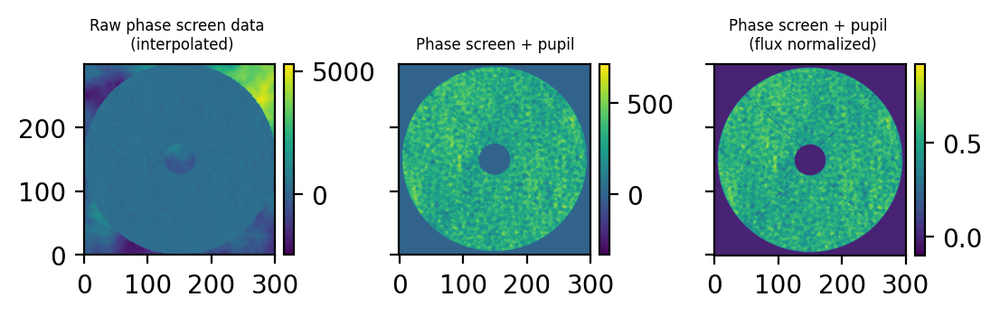

In [16]:
f, (ax1, ax2, ax3) = plt.subplots(1, 3, sharey=True, dpi=200)
ax1.set_title('Raw phase screen data \n (interpolated)', fontsize=6)
z1 = ax1.imshow(phase_screen_1arcsec_interp, origin='lower')
ax1.set_xticks([0, 100, 200, 300])
ax1.set_yticks([0, 100, 200, 300])
divider = make_axes_locatable(ax1)
cax1 = divider.append_axes('right', size='5%', pad=0.05)
plt.colorbar(z1, cax=cax1)

ax2.set_title('Phase screen + pupil', fontsize=6)
z2 = ax2.imshow(phase_screen_1arcsec_interp*pupil.reshape(300,300), origin='lower')
ax2.set_xticks([0, 100, 200, 300])
ax2.set_yticks([0, 100, 200, 300])
divider = make_axes_locatable(ax2)
cax2 = divider.append_axes('right', size='5%', pad=0.05)
plt.colorbar(z2, cax=cax2)

ax3.set_title('Phase screen + pupil \n (flux normalized)', fontsize=6)
z3 = ax3.imshow(((phase_screen_1arcsec_interp + np.percentile(phase_screen_1arcsec_interp, 25))/(np.percentile(phase_screen_1arcsec_interp, 94) + np.percentile(phase_screen_1arcsec_interp, 25)))*pupil.reshape(300,300), origin='lower')
ax3.set_xticks([0, 100, 200, 300])
ax3.set_yticks([0, 100, 200, 300])
divider = make_axes_locatable(ax3)
cax3 = divider.append_axes('right', size='5%', pad=0.05)
plt.colorbar(z3, cax=cax3)

plt.subplots_adjust(wspace=.5)
plt.savefig('plots/phase_screen_normalized.png', dpi=200, bbox_inches='tight')

Let's take a look at the input and output masks

### 0_GPI_N300_FPM280M0300_IWA0500_OWA02200_C7_BW20_Nlam5_LS_ID04_ov_ODp01__ls_truts_no_tab

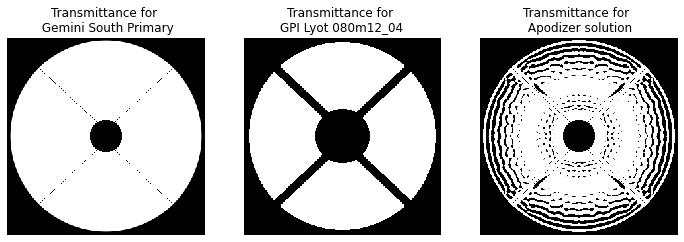

In [9]:
plt.figure(figsize=(12,6))
plt.subplot(1,3,1)
plt.title('Transmittance for \n Gemini South Primary')
plt.axis('off')
imshow_field(pupil, cmap='bone')
plt.subplot(1,3,2)
plt.title('Transmittance for \n'+lyot_name)
plt.axis('off')
imshow_field(lyot_stop, cmap='gray')
plt.subplot(1,3,3)
plt.title('Transmittance for \n Apodizer solution')
plt.axis('off')
imshow_field(apodizer, cmap='gray')

### gpi_aplc_2_test_N0300_telserv3

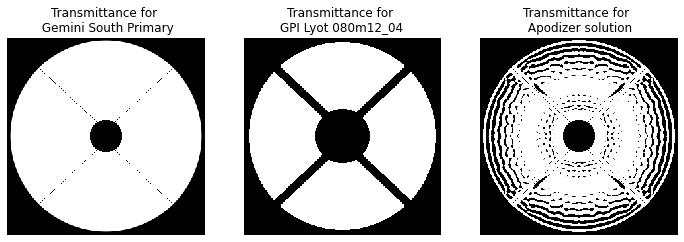

In [8]:
plt.figure(figsize=(12,6))
plt.subplot(1,3,1)
plt.title('Transmittance for \n Gemini South Primary')
plt.axis('off')
imshow_field(pupil, cmap='bone')
plt.subplot(1,3,2)
plt.title('Transmittance for \n'+lyot_name)
plt.axis('off')
imshow_field(lyot_stop, cmap='gray')
plt.subplot(1,3,3)
plt.title('Transmittance for \n Apodizer solution')
plt.axis('off')
imshow_field(apodizer, cmap='gray')

And now lets compare with gpipsfs.


In [10]:
# Set up a GPI simulator instance with that apodizer and with the primary and Lyot stop adjusted to be symmetric
gpi = gpipsfs.GPI(custom_apodizer_path=solution,  npix=npix, display_before=False, lyot_tabs=False, force_symmetric_primary = False)
gpi.options['output_mode'] = 'oversampled' # return oversampled arrays (rather than binning to IFS resolution)
oversampling=4

Compute the wavelength for which the ratio of FPM diameter / lambda/D is precisely consistent with the APLC design code.



In [11]:
fpm_r = gpipsfs.GPI_FPM("H").radius*u.milliarcsecond
d_pri = gpipsfs.GeminiPrimary.primary_diameter*u.m
apod_header = fits.getheader(solution)
fpm_in_lambdaD = apod_header['FPM_RAD']

ref_wavelen = (fpm_r.to_value(u.radian)*d_pri / fpm_in_lambdaD).to_value(u.m)

print(f"APLC design optimized for FPM = {fpm_in_lambdaD} lam/D. For the GPI H FPM, that equality is true at {ref_wavelen*1e6:.3f} microns")

APLC design optimized for FPM = 2.8 lam/D. For the GPI H FPM, that equality is true at 1.645 microns


------------------------------

# Analysis

## 1.0 Contrast

## Broadband PSF generation

### With aberration

In [40]:
broadband_results = calc_psf(pupil*apodizer, .2, 1, 3, lyot_stop, focal_plane_mask)

/home/mmnguyen/anaconda3/lib/python3.7/site-packages/hcipy/optics/aberration.py:37: RuntimeWarning: divide by zero encountered in power
  res = Field(grid.as_('polar').r**exponent, grid)


In [41]:
unocc_psf = broadband_results['unocculted_psf']
occ_psf = broadband_results['occulted_psf']
unocc_psf_ab = broadband_results['unocculted_psf_ab']
occ_psf_ab = broadband_results['occulted_psf_ab']

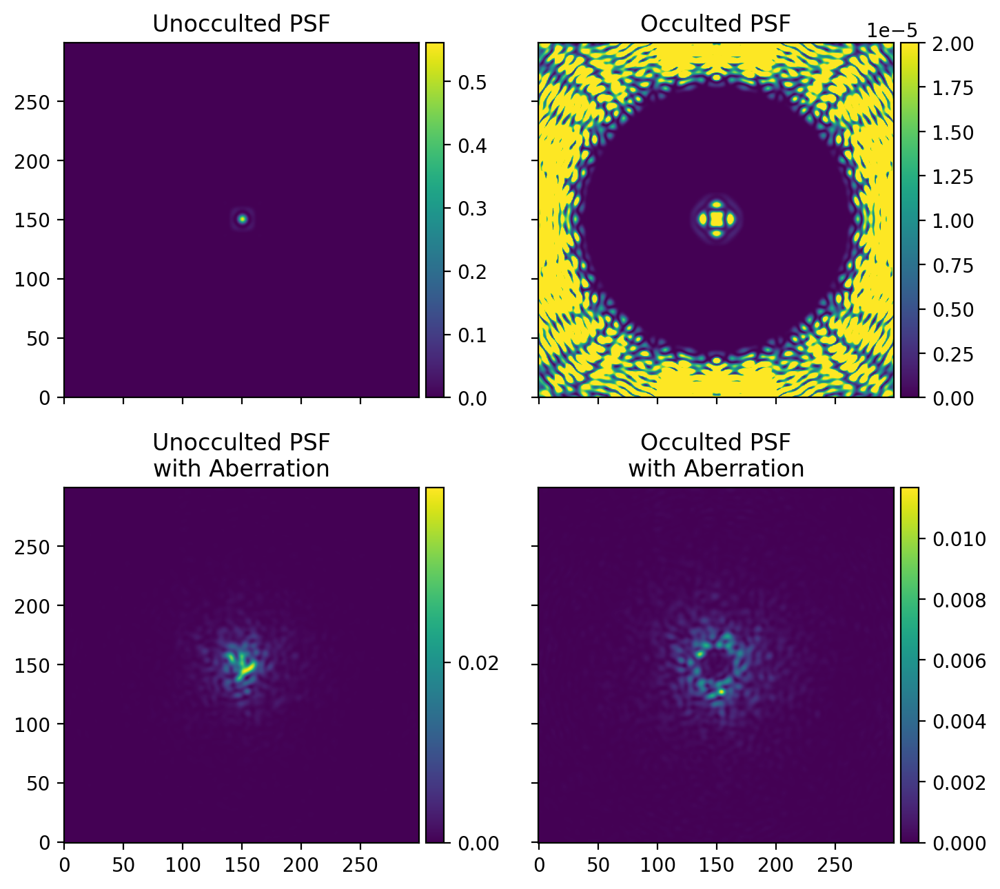

In [27]:
f, ((ax1,ax2),(ax3,ax4)) = plt.subplots(2, 2, figsize=(8,8), dpi=200, sharex=True, sharey=True)

z1 = ax1.imshow(unocc_psf.reshape(300,300), origin='lower', vmin=0)
z2 = ax2.imshow(occ_psf.reshape(300,300), origin='lower', vmin=0, vmax=.00002)
z3 = ax3.imshow(unocc_psf_ab.reshape(300,300), origin='lower', vmin=0)
z4 = ax4.imshow(occ_psf_ab.reshape(300,300), origin='lower', vmin=0)

ax1.set_title('Unocculted PSF')
ax2.set_title('Occulted PSF')
ax3.set_title('Unocculted PSF\nwith Aberration')
ax4.set_title('Occulted PSF\nwith Aberration')

divider1 = make_axes_locatable(ax1)
cax1 = divider1.append_axes("right", size="5%", pad=0.05)
plt.colorbar(z1,cax=cax1)

divider2 = make_axes_locatable(ax2)
cax2 = divider2.append_axes("right", size="5%", pad=0.05)
plt.colorbar(z2,cax=cax2)

divider3 = make_axes_locatable(ax3)
cax3 = divider3.append_axes("right", size="5%", pad=0.05)
plt.colorbar(z3,cax=cax3, ticks=[0, .02, .04, .06, .08])

divider4 = make_axes_locatable(ax4)
cax4 = divider4.append_axes("right", size="5%", pad=0.05)
plt.colorbar(z4,cax=cax4)

plt.subplots_adjust(hspace=.15, wspace=.25)
plt.savefig('plots/broadband_PSF_v2.png', dpi=300, bbox_inches='tight')

In [294]:
iwa, owa, contrast, radius_fpm = parameters['image']['iwa'], parameters['image']['owa'], parameters['image']['contrast'], parameters['focal_plane_mask']['radius']

coro = LyotCoronagraph(pupil.grid, focal_plane_mask, lyot_stop)
focal_grid = make_focal_grid(8, owa * 1.2)                       
prop = FraunhoferPropagator(pupil.grid, focal_grid)               
wf = Wavefront(pupil * apodizer)
img = prop(coro(wf)).intensity
img_ref = prop(Wavefront(apodizer * lyot_stop)).intensity
r, profile, std_profile, n_profile = radial_profile(img / max(img_ref), 0.2)

### No aberration with phase screen

In [57]:
broadband_results_ps = calc_psf(pupil*apodizer*(phase_screen_1arcsec_interp.ravel()/1200), .2, 1, 3, lyot_stop, focal_plane_mask)

/home/mmnguyen/anaconda3/lib/python3.7/site-packages/hcipy/optics/aberration.py:37: RuntimeWarning: divide by zero encountered in power
  res = Field(grid.as_('polar').r**exponent, grid)


In [58]:
unocc_psf_ps = broadband_results_ps['unocculted_psf']
occ_psf_ps = broadband_results_ps['occulted_psf']
unocc_psf_ab_ps = broadband_results_ps['unocculted_psf_ab']
occ_psf_ab_ps = broadband_results_ps['occulted_psf_ab']

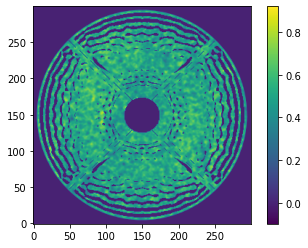

In [64]:
plt.imshow((((phase_screen_1arcsec_interp + np.percentile(phase_screen_1arcsec_interp, 25))/(np.percentile(phase_screen_1arcsec_interp, 94) + np.percentile(phase_screen_1arcsec_interp, 25))).ravel()*pupil*apodizer).reshape(300,300), origin='lower')
plt.colorbar()

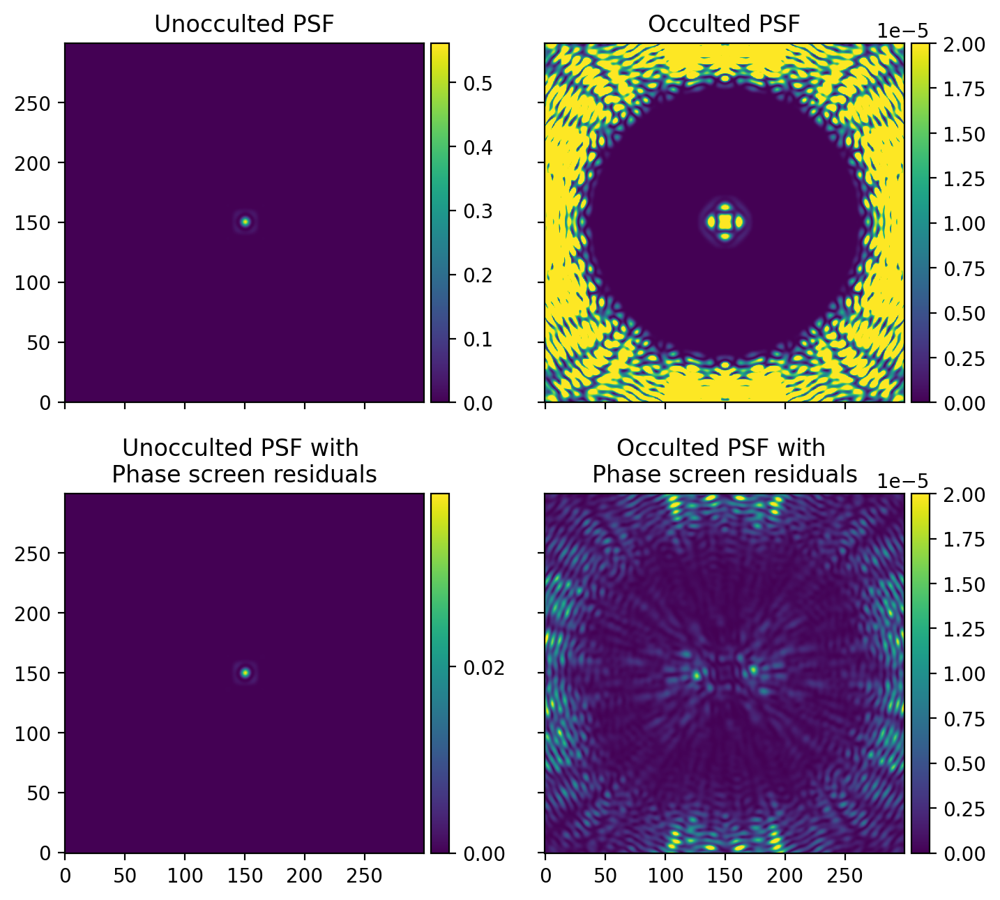

In [68]:
f, ((ax1,ax2),(ax3,ax4)) = plt.subplots(2, 2, figsize=(8,8), dpi=200, sharex=True, sharey=True)

z1 = ax1.imshow(unocc_psf.reshape(300,300), origin='lower', vmin=0)
z2 = ax2.imshow(occ_psf.reshape(300,300), origin='lower', vmin=0, vmax=.00002)
z3 = ax3.imshow(unocc_psf_ps.reshape(300,300), origin='lower', vmin=0)
z4 = ax4.imshow(occ_psf_ps.reshape(300,300), origin='lower', vmin=0, vmax=.00002)

ax1.set_title('Unocculted PSF')
ax2.set_title('Occulted PSF')
ax3.set_title('Unocculted PSF with \nPhase screen residuals')
ax4.set_title('Occulted PSF with \nPhase screen residuals')

divider1 = make_axes_locatable(ax1)
cax1 = divider1.append_axes("right", size="5%", pad=0.05)
plt.colorbar(z1,cax=cax1)

divider2 = make_axes_locatable(ax2)
cax2 = divider2.append_axes("right", size="5%", pad=0.05)
plt.colorbar(z2,cax=cax2)

divider3 = make_axes_locatable(ax3)
cax3 = divider3.append_axes("right", size="5%", pad=0.05)
plt.colorbar(z3,cax=cax3, ticks=[0, .02, .04, .06, .08])

divider4 = make_axes_locatable(ax4)
cax4 = divider4.append_axes("right", size="5%", pad=0.05)
plt.colorbar(z4,cax=cax4)

plt.subplots_adjust(hspace=.15, wspace=.25)
plt.savefig('plots/broadband_PSF_w_phase_screen.png', dpi=300, bbox_inches='tight')

In [70]:
r, profile, std_profile, n_profile = radial_profile(occ_psf_ps / max(unocc_psf_ps), 0.2)

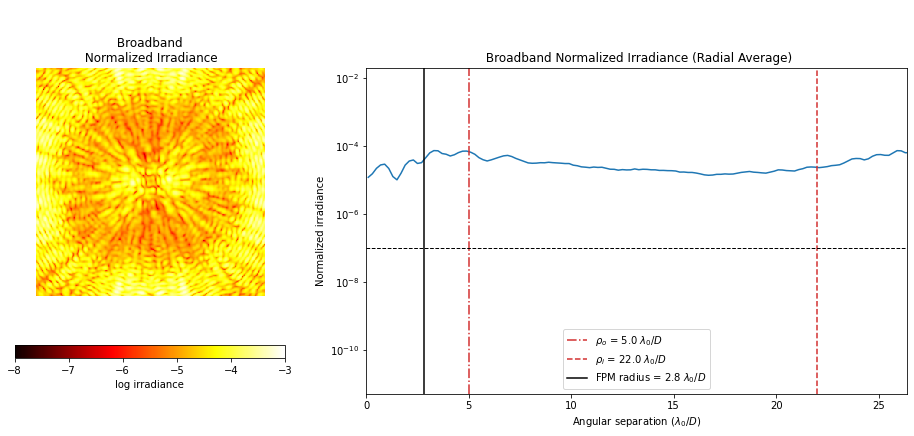

In [72]:
plt.figure(figsize=(16,6))
gs = gridspec.GridSpec(1, 2, width_ratios=[1, 2]) 
plt.subplot(gs[0])
plt.title('\n\n Broadband \n Normalized Irradiance', fontsize=12)
imshow_field(np.log10(occ_psf_ps / max(unocc_psf_ps)), vmin=-contrast - 1, vmax=-contrast + 4, cmap='hot')
cbar = plt.colorbar(orientation='horizontal')
cbar.set_label('log irradiance')
plt.axis('off')
#plt.xlabel('Angular coordinate ($\lambda_0/D$)', fontsize=14)
#plt.ylabel('Angular coordinate ($\lambda_0/D$)', fontsize=14)
plt.tick_params(axis='both', labelsize=8)
plt.subplot(gs[1])
plt.title('\n Broadband Normalized Irradiance (Radial Average)')
plt.plot(r, profile)
iwa_line = plt.axvline(iwa, color=colors.red, linestyle = '-.')
owa_line = plt.axvline(owa, color=colors.red, linestyle = '--')
radius_line = plt.axvline(radius_fpm, color='k')
plt.axhline(10 ** (-contrast), xmin=0, xmax=owa * 1.2, linewidth=1, color='k', linestyle='--')
plt.legend([iwa_line, owa_line, radius_line],
               [r'$\rho_o$ = '+str(float(iwa))+r' $\lambda_0/D$', r'$\rho_i$ = '+str(float(owa))+r' $\lambda_0/D$',
                'FPM radius = '+str(float(radius_fpm))+r' $\lambda_0/D$'])


plt.yscale('log')
plt.xlim(0, owa * 1.2)
plt.ylim(5e-12, 2e-2)
plt.ylabel('Normalized irradiance')
plt.xlabel(r'Angular separation ($\lambda_0/D$)')
plt.savefig('plots/bb_gpi_psf_w_phase_screen.png', dpi=300, bbox_inches='tight')

### Timing the PSF generation for no aberration with phase screen

/home/mmnguyen/anaconda3/lib/python3.7/site-packages/hcipy/optics/aberration.py:37: RuntimeWarning: divide by zero encountered in power
  res = Field(grid.as_('polar').r**exponent, grid)


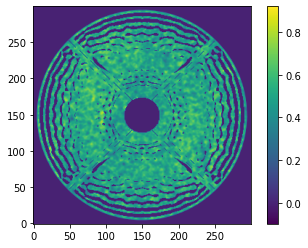

<Figure size 432x288 with 0 Axes>

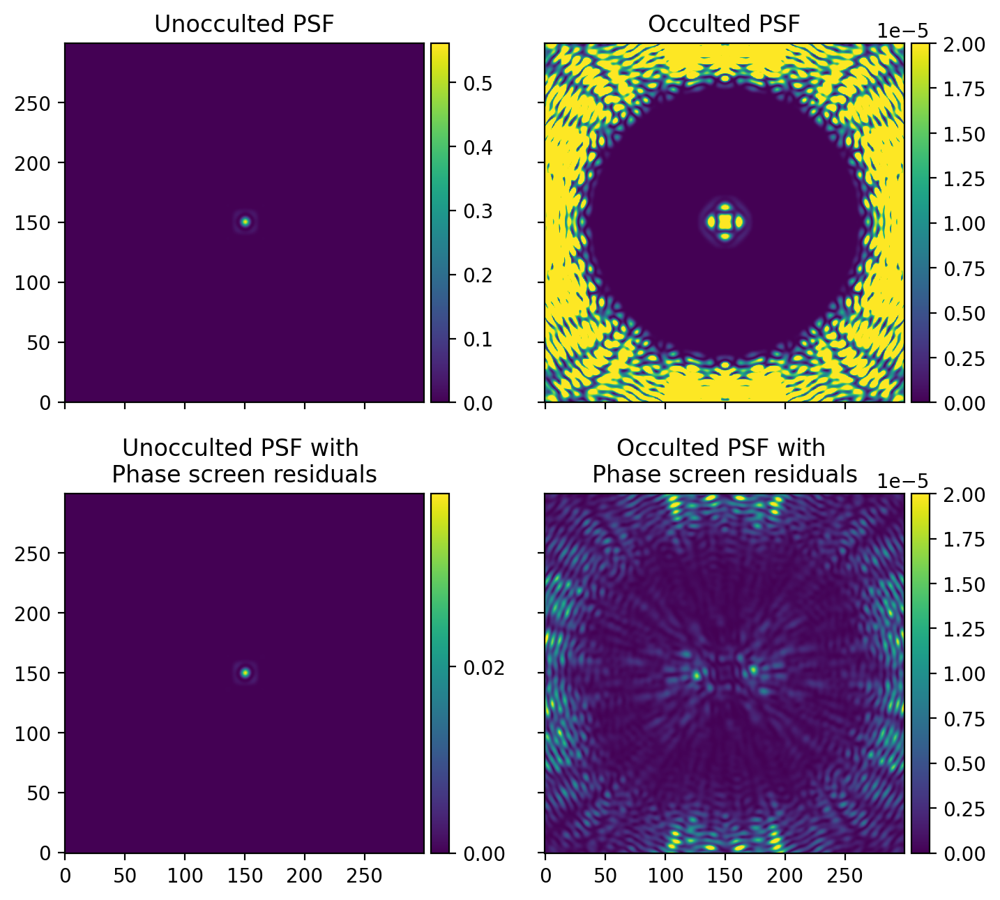

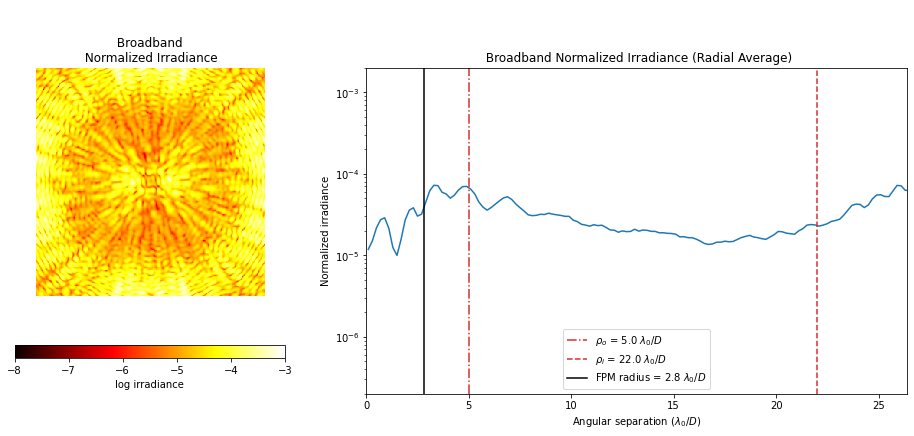

PSF generation took 2.100 s
Plotting took 2.467 s
Contrast curve generation took 0.165 s


In [31]:
time1 = time.time()

broadband_results_ps = calc_psf(pupil*apodizer*(phase_screen_1arcsec_interp.ravel()/1200), .2, 1, 3, lyot_stop, focal_plane_mask)

unocc_psf_ps = broadband_results_ps['unocculted_psf']
occ_psf_ps = broadband_results_ps['occulted_psf']
unocc_psf_ab_ps = broadband_results_ps['unocculted_psf_ab']
occ_psf_ab_ps = broadband_results_ps['occulted_psf_ab']

time2 = time.time()

plt.figure()
plt.imshow((((phase_screen_1arcsec_interp + np.percentile(phase_screen_1arcsec_interp, 25))/(np.percentile(phase_screen_1arcsec_interp, 94) + np.percentile(phase_screen_1arcsec_interp, 25))).ravel()*pupil*apodizer).reshape(300,300), origin='lower')
plt.colorbar()
plt.show()
plt.close()

plt.figure()
f, ((ax1,ax2),(ax3,ax4)) = plt.subplots(2, 2, figsize=(8,8), dpi=200, sharex=True, sharey=True)

z1 = ax1.imshow(unocc_psf.reshape(300,300), origin='lower', vmin=0)
z2 = ax2.imshow(occ_psf.reshape(300,300), origin='lower', vmin=0, vmax=.00002)
z3 = ax3.imshow(unocc_psf_ps.reshape(300,300), origin='lower', vmin=0)
z4 = ax4.imshow(occ_psf_ps.reshape(300,300), origin='lower', vmin=0, vmax=.00002)

ax1.set_title('Unocculted PSF')
ax2.set_title('Occulted PSF')
ax3.set_title('Unocculted PSF with \nPhase screen residuals')
ax4.set_title('Occulted PSF with \nPhase screen residuals')

divider1 = make_axes_locatable(ax1)
cax1 = divider1.append_axes("right", size="5%", pad=0.05)
plt.colorbar(z1,cax=cax1)

divider2 = make_axes_locatable(ax2)
cax2 = divider2.append_axes("right", size="5%", pad=0.05)
plt.colorbar(z2,cax=cax2)

divider3 = make_axes_locatable(ax3)
cax3 = divider3.append_axes("right", size="5%", pad=0.05)
plt.colorbar(z3,cax=cax3, ticks=[0, .02, .04, .06, .08])

divider4 = make_axes_locatable(ax4)
cax4 = divider4.append_axes("right", size="5%", pad=0.05)
plt.colorbar(z4,cax=cax4)

plt.subplots_adjust(hspace=.15, wspace=.25)
plt.show()
plt.close()

time3 = time.time()

r, profile, std_profile, n_profile = radial_profile(occ_psf_ps / max(unocc_psf_ps), 0.2)

time4 = time.time()

plt.figure(figsize=(16,6))
gs = gridspec.GridSpec(1, 2, width_ratios=[1, 2]) 
plt.subplot(gs[0])
plt.title('\n\n Broadband \n Normalized Irradiance', fontsize=12)
imshow_field(np.log10(occ_psf_ps / max(unocc_psf_ps)), vmin=-contrast - 1, vmax=-contrast + 4, cmap='hot')
cbar = plt.colorbar(orientation='horizontal')
cbar.set_label('log irradiance')
plt.axis('off')
#plt.xlabel('Angular coordinate ($\lambda_0/D$)', fontsize=14)
#plt.ylabel('Angular coordinate ($\lambda_0/D$)', fontsize=14)
plt.tick_params(axis='both', labelsize=8)
plt.subplot(gs[1])
plt.title('\n Broadband Normalized Irradiance (Radial Average)')
plt.plot(r, profile)
iwa_line = plt.axvline(iwa, color=colors.red, linestyle = '-.')
owa_line = plt.axvline(owa, color=colors.red, linestyle = '--')
radius_line = plt.axvline(radius_fpm, color='k')
plt.axhline(10 ** (-contrast), xmin=0, xmax=owa * 1.2, linewidth=1, color='k', linestyle='--')
plt.legend([iwa_line, owa_line, radius_line],
               [r'$\rho_o$ = '+str(float(iwa))+r' $\lambda_0/D$', r'$\rho_i$ = '+str(float(owa))+r' $\lambda_0/D$',
                'FPM radius = '+str(float(radius_fpm))+r' $\lambda_0/D$'])


plt.yscale('log')
plt.xlim(0, owa * 1.2)
plt.ylim(2e-7, 2e-3)
plt.ylabel('Normalized irradiance')
plt.xlabel(r'Angular separation ($\lambda_0/D$)')
plt.show()
plt.close()

time5 = time.time()
print('PSF generation took {0:.3f} s'.format((time2-time1)))
print('Plotting took {0:.3f} s'.format(((time3-time2) + (time5-time4))))
print('Contrast curve generation took {0:.3f} s'.format(time4-time3))

### No aberration with phase screen in for loop

/home/mmnguyen/anaconda3/lib/python3.7/site-packages/hcipy/optics/aberration.py:37: RuntimeWarning: divide by zero encountered in power
  res = Field(grid.as_('polar').r**exponent, grid)


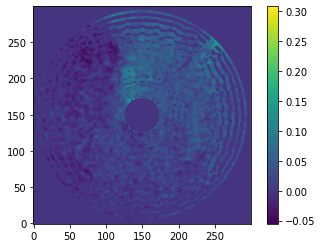

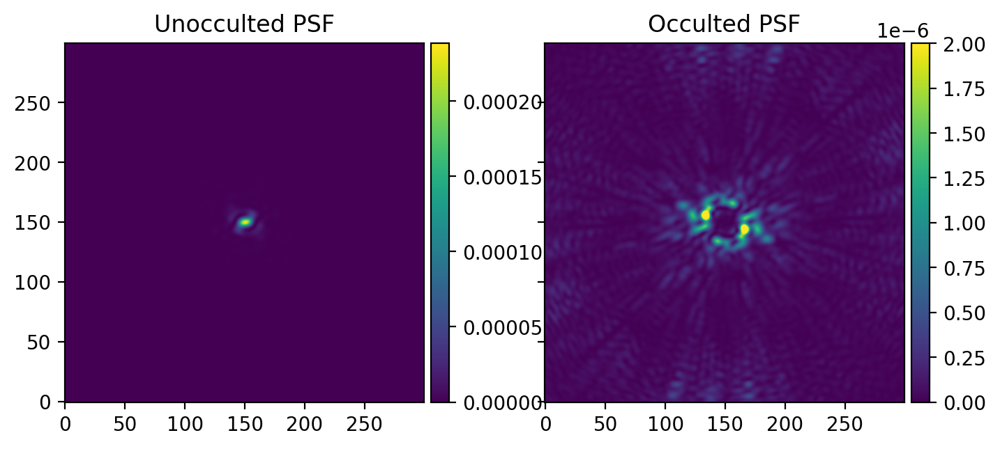

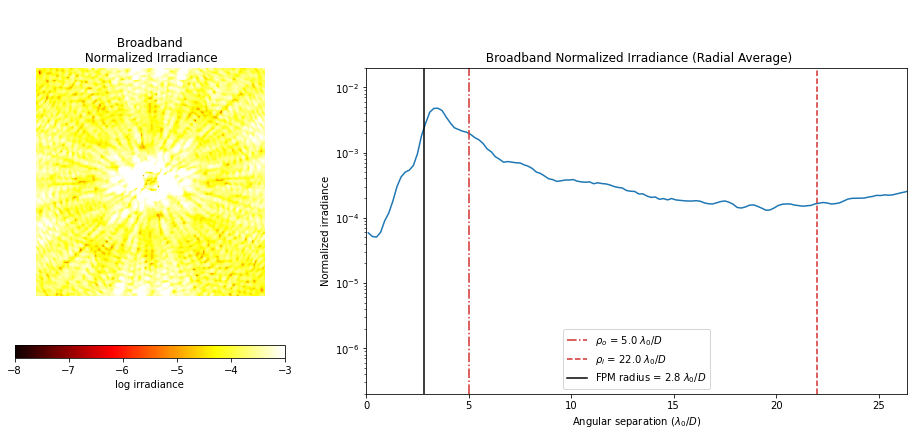

PSF generation took 1.172 s
Plotting took 1.666 s
Contrast curve generation took 0.069 s


/home/mmnguyen/anaconda3/lib/python3.7/site-packages/hcipy/optics/aberration.py:37: RuntimeWarning: divide by zero encountered in power
  res = Field(grid.as_('polar').r**exponent, grid)


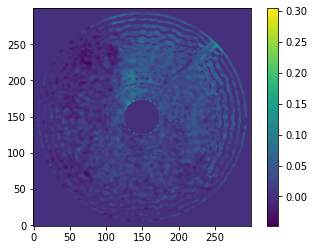

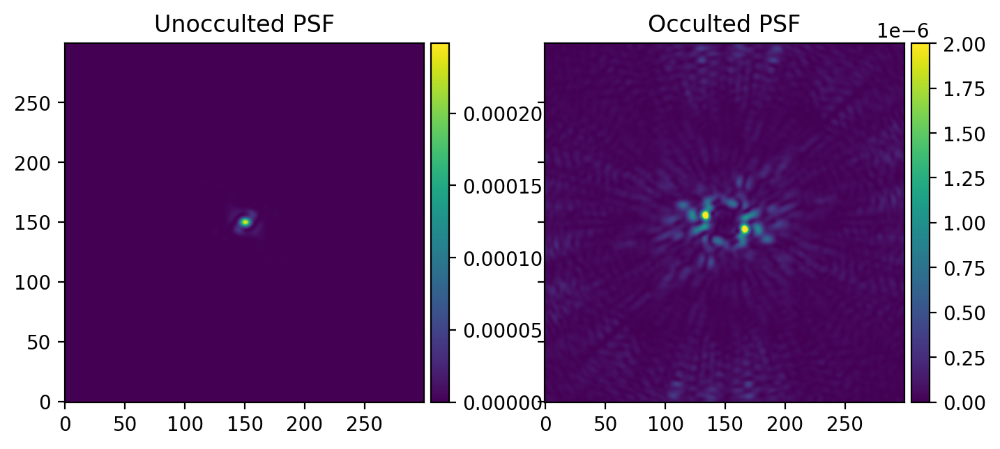

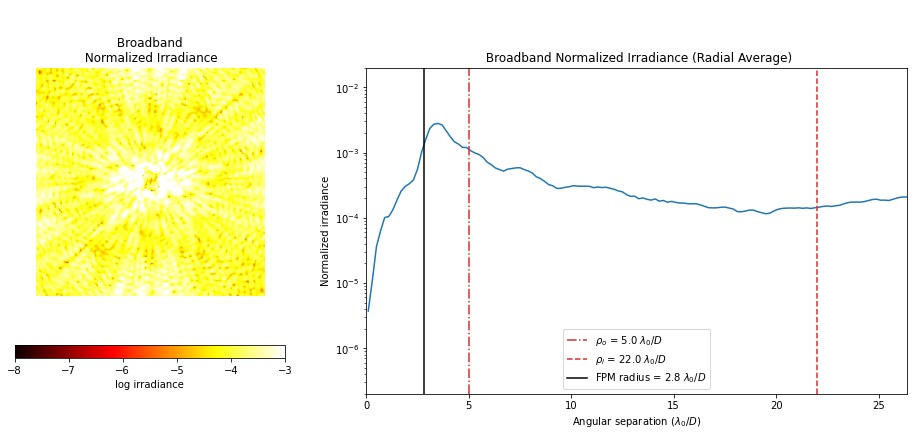

PSF generation took 1.251 s
Plotting took 1.757 s
Contrast curve generation took 0.067 s


/home/mmnguyen/anaconda3/lib/python3.7/site-packages/hcipy/optics/aberration.py:37: RuntimeWarning: divide by zero encountered in power
  res = Field(grid.as_('polar').r**exponent, grid)


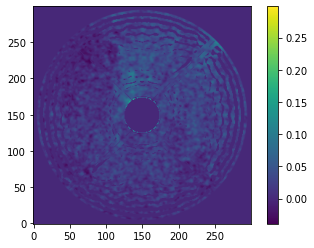

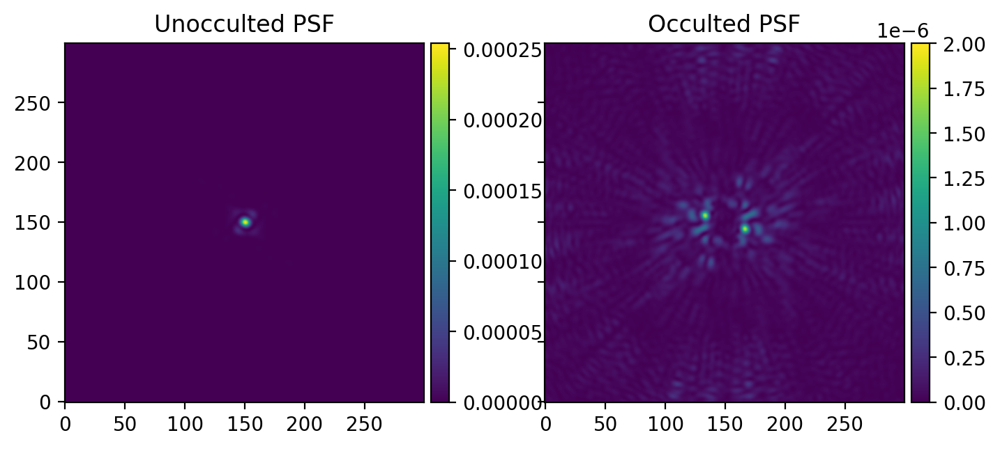

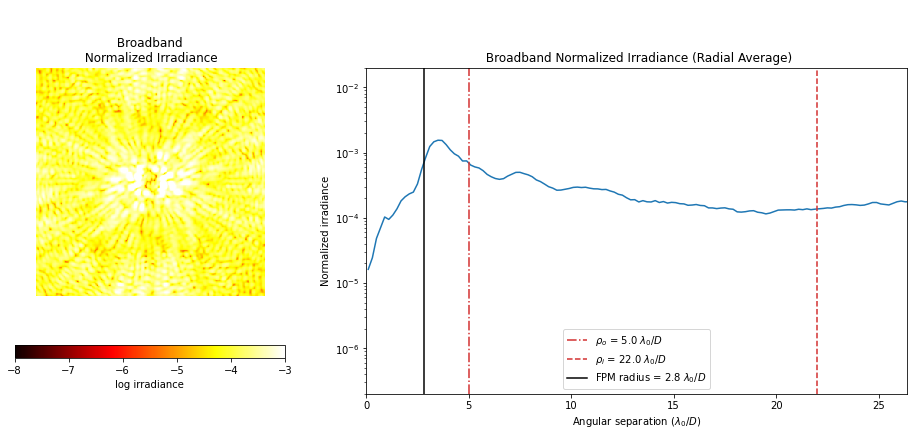

PSF generation took 1.188 s
Plotting took 1.602 s
Contrast curve generation took 0.069 s


/home/mmnguyen/anaconda3/lib/python3.7/site-packages/hcipy/optics/aberration.py:37: RuntimeWarning: divide by zero encountered in power
  res = Field(grid.as_('polar').r**exponent, grid)


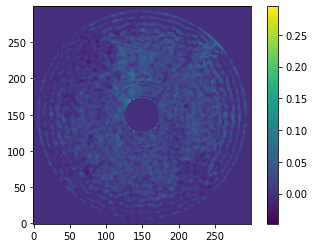

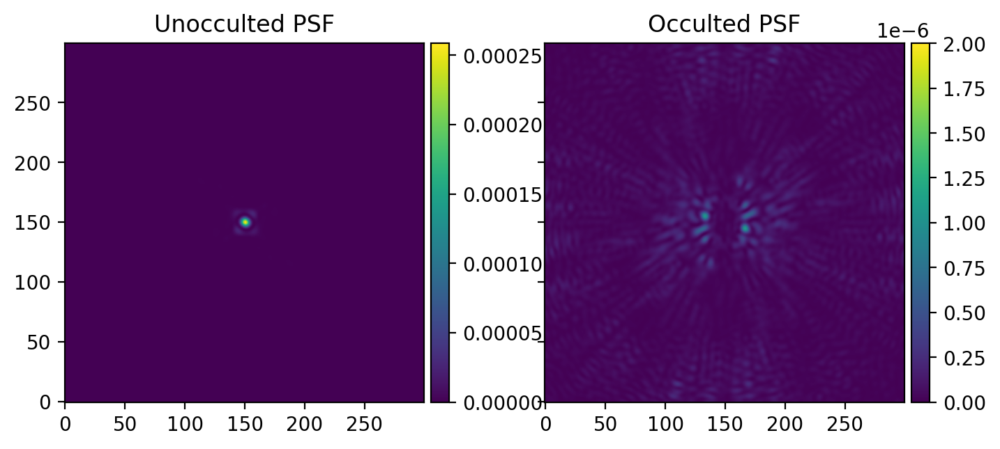

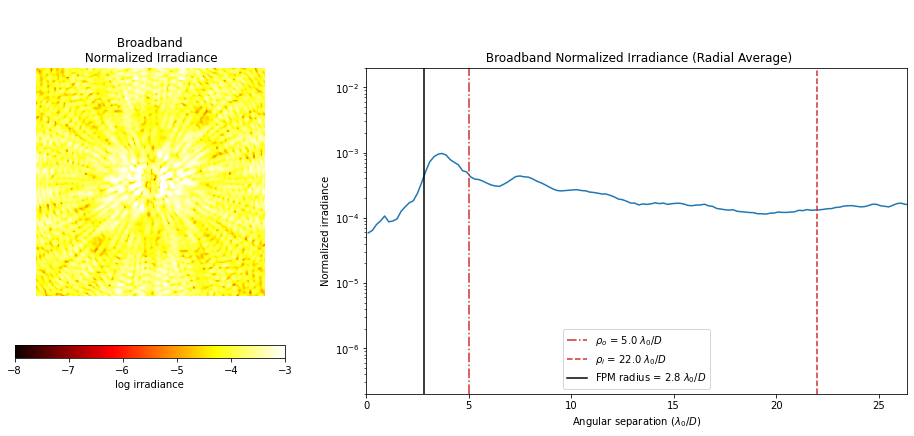

PSF generation took 0.933 s
Plotting took 1.641 s
Contrast curve generation took 0.065 s


/home/mmnguyen/anaconda3/lib/python3.7/site-packages/hcipy/optics/aberration.py:37: RuntimeWarning: divide by zero encountered in power
  res = Field(grid.as_('polar').r**exponent, grid)


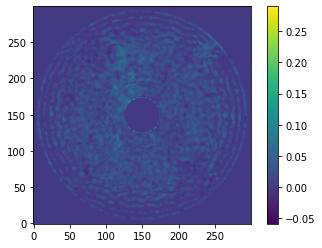

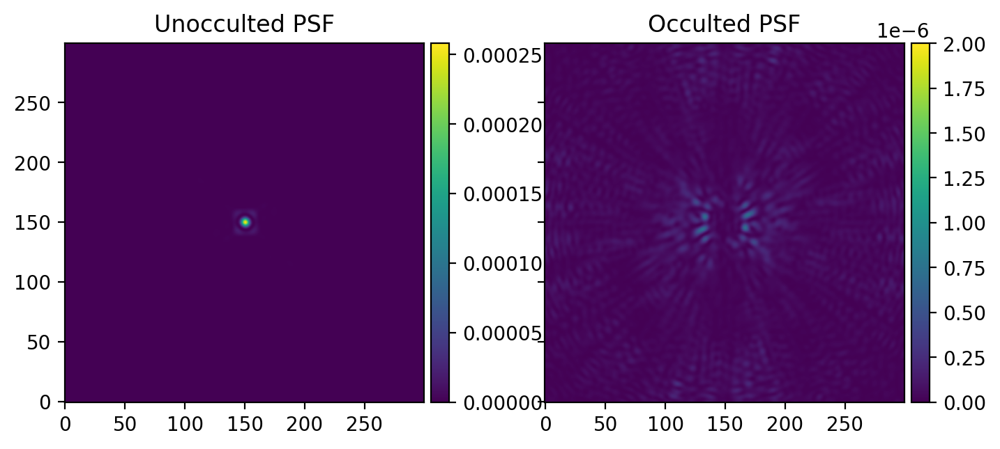

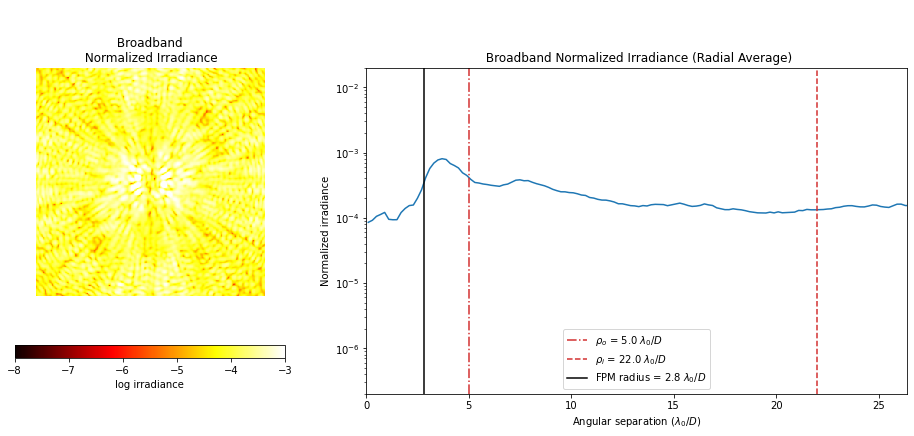

PSF generation took 1.065 s
Plotting took 1.575 s
Contrast curve generation took 0.065 s


/home/mmnguyen/anaconda3/lib/python3.7/site-packages/hcipy/optics/aberration.py:37: RuntimeWarning: divide by zero encountered in power
  res = Field(grid.as_('polar').r**exponent, grid)


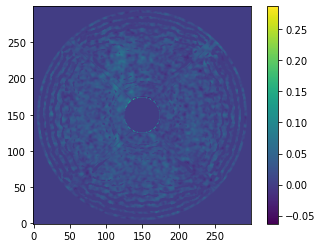

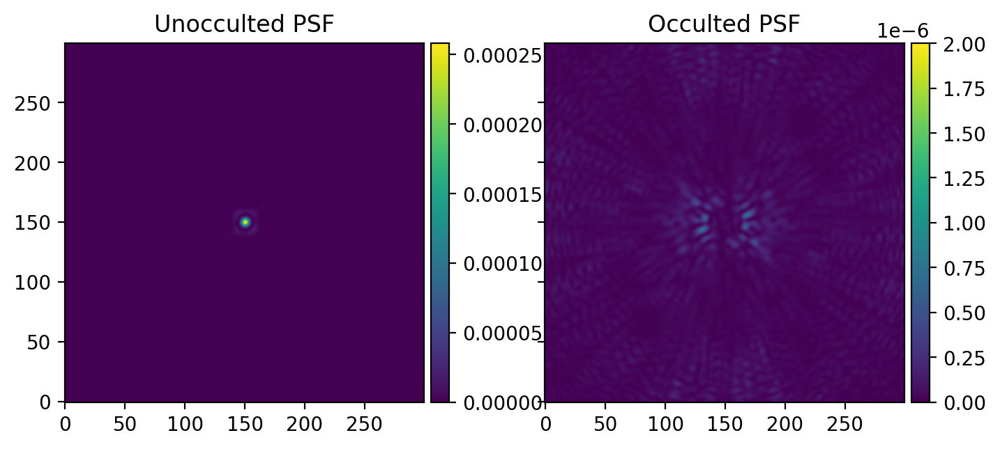

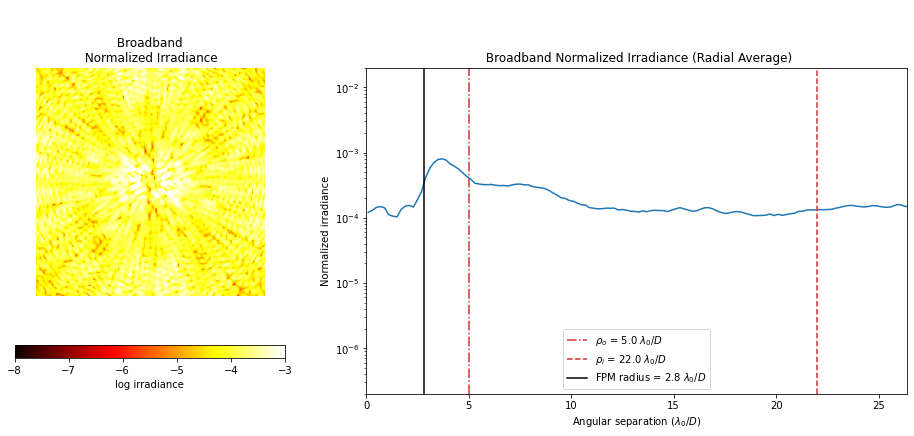

PSF generation took 1.343 s
Plotting took 1.735 s
Contrast curve generation took 0.068 s


/home/mmnguyen/anaconda3/lib/python3.7/site-packages/hcipy/optics/aberration.py:37: RuntimeWarning: divide by zero encountered in power
  res = Field(grid.as_('polar').r**exponent, grid)


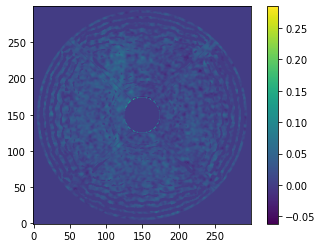

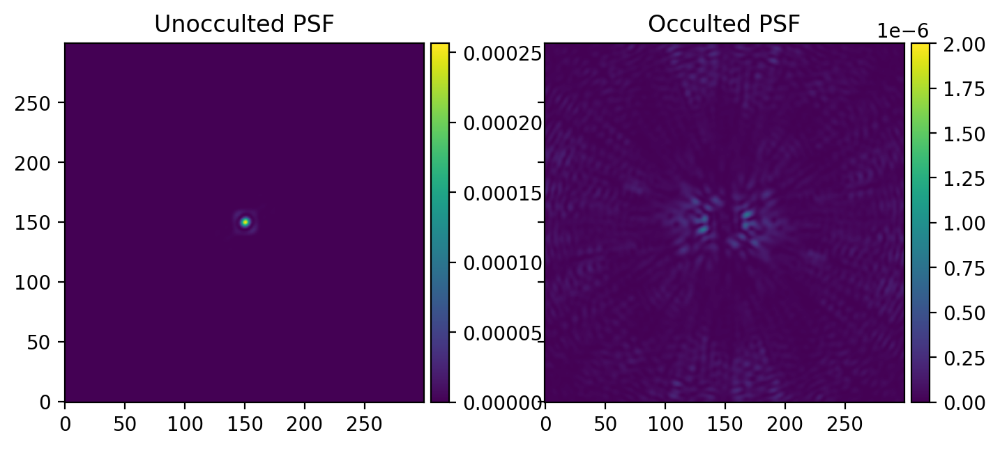

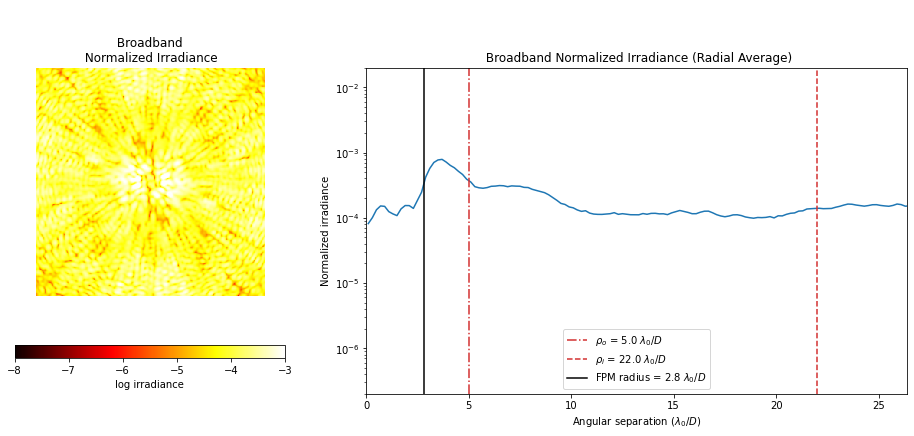

PSF generation took 1.176 s
Plotting took 1.697 s
Contrast curve generation took 0.075 s


/home/mmnguyen/anaconda3/lib/python3.7/site-packages/hcipy/optics/aberration.py:37: RuntimeWarning: divide by zero encountered in power
  res = Field(grid.as_('polar').r**exponent, grid)


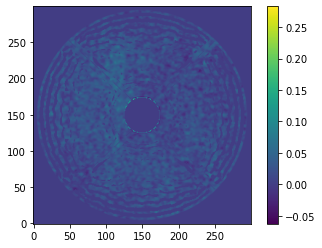

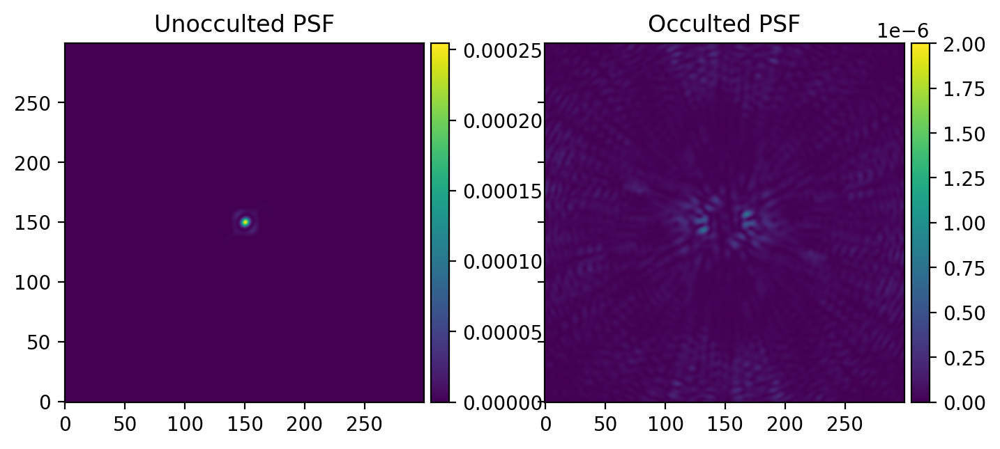

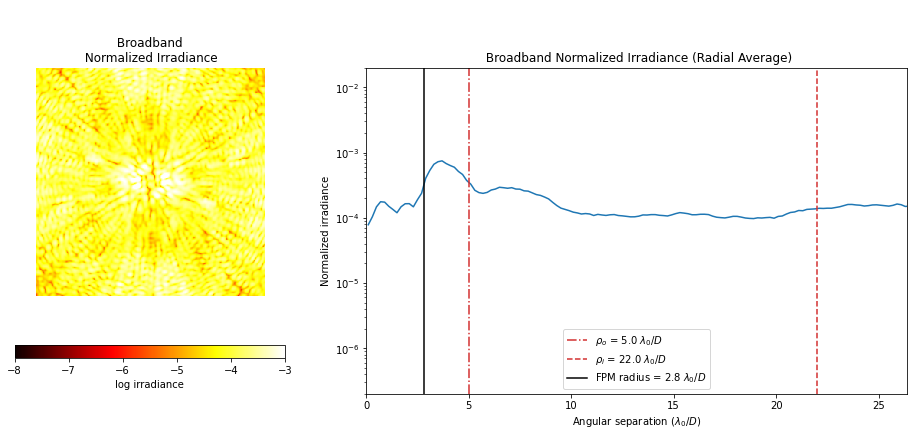

PSF generation took 1.088 s
Plotting took 1.653 s
Contrast curve generation took 0.066 s


/home/mmnguyen/anaconda3/lib/python3.7/site-packages/hcipy/optics/aberration.py:37: RuntimeWarning: divide by zero encountered in power
  res = Field(grid.as_('polar').r**exponent, grid)


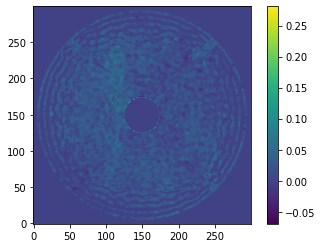

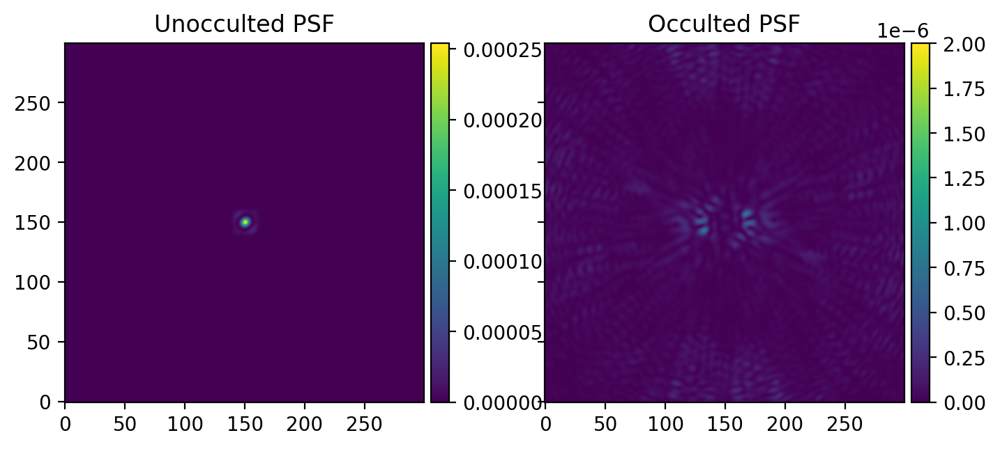

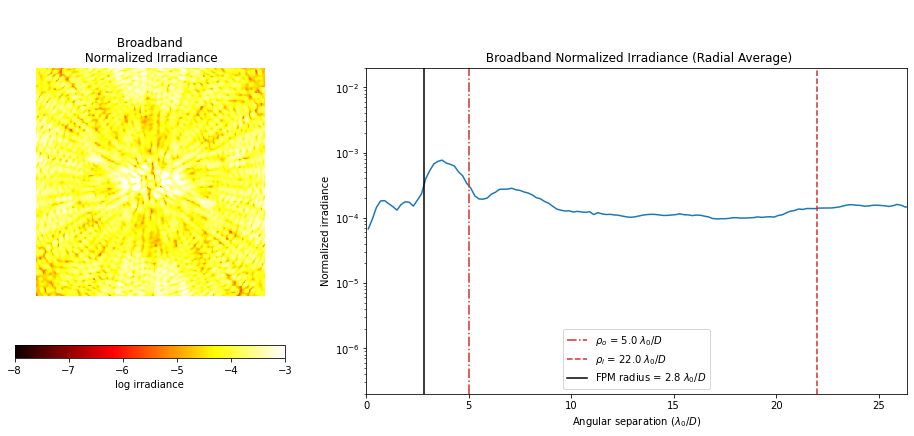

PSF generation took 0.970 s
Plotting took 1.590 s
Contrast curve generation took 0.065 s


/home/mmnguyen/anaconda3/lib/python3.7/site-packages/hcipy/optics/aberration.py:37: RuntimeWarning: divide by zero encountered in power
  res = Field(grid.as_('polar').r**exponent, grid)


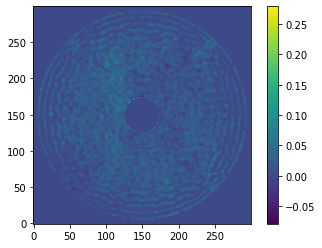

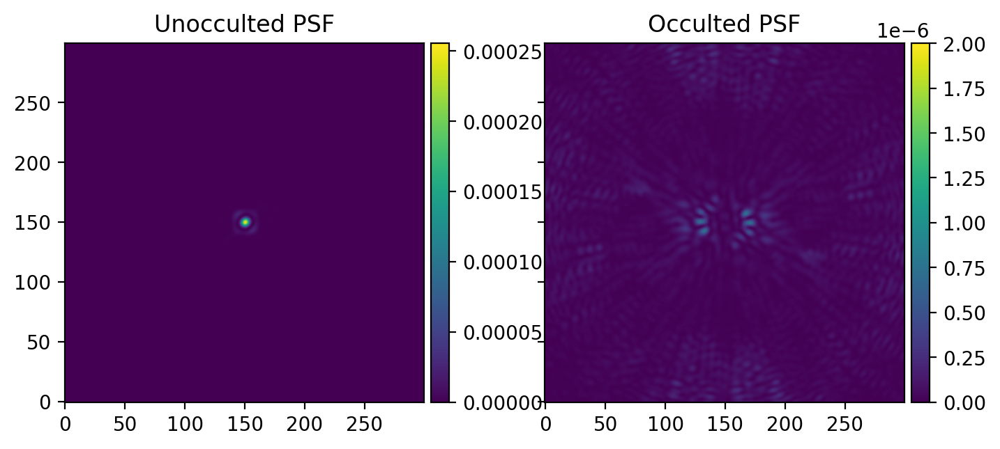

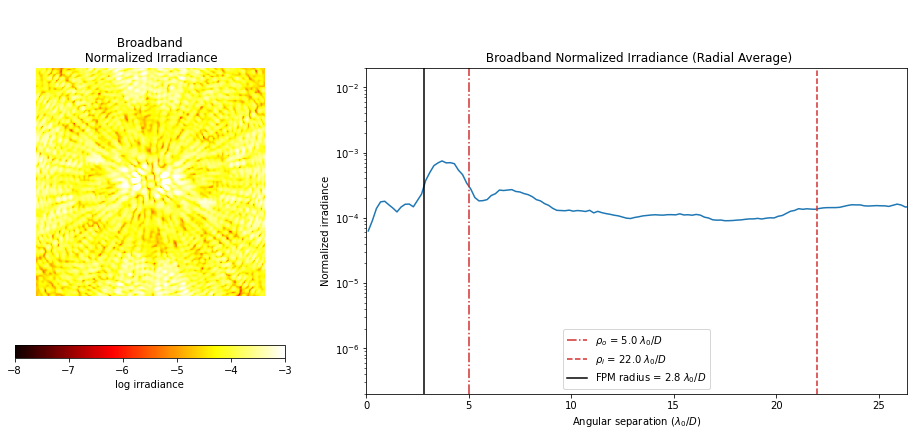

PSF generation took 1.205 s
Plotting took 1.665 s
Contrast curve generation took 0.067 s


In [33]:
x, y = np.meshgrid(np.arange(300, dtype=np.float64), np.arange(300, dtype=np.float64))

for i in range(10):
    
    time1 = time.time()
    
    phase_screen_1arcsec_interp = zoom(phase_screen_1arcsec_seeing[:,:,i+20], 300./176.)
    broadband_results = calc_psf(pupil*apodizer*(phase_screen_1arcsec_interp.ravel()/np.max(phase_screen_1arcsec_interp)), .2, 1, 3, lyot_stop, focal_plane_mask)
    
    unocc_psf = broadband_results['unocculted_psf']
    occ_psf = broadband_results['occulted_psf']
    unocc_psf_ab = broadband_results['unocculted_psf_ab']
    occ_psf_ab = broadband_results['occulted_psf_ab']
    
    time2 = time.time()
    
    plt.figure()
    plt.imshow((pupil*apodizer*(phase_screen_1arcsec_interp.ravel()/np.max(phase_screen_1arcsec_interp))).reshape(300,300), origin='lower')
    plt.colorbar()
    plt.show()
    plt.close()
    
    f, (ax1,ax2) = plt.subplots(1, 2, figsize=(8,8), dpi=200, sharex=True, sharey=True)

    z1 = ax1.imshow(unocc_psf.reshape(300,300), origin='lower', vmin=0)
    z2 = ax2.imshow(occ_psf.reshape(300,300), origin='lower', vmin=0, vmax=.000002)
    ax1.set_title('Unocculted PSF')
    ax2.set_title('Occulted PSF')

    divider1 = make_axes_locatable(ax1)
    cax1 = divider1.append_axes("right", size="5%", pad=0.05)
    plt.colorbar(z1,cax=cax1)

    divider2 = make_axes_locatable(ax2)
    cax2 = divider2.append_axes("right", size="5%", pad=0.05)
    plt.colorbar(z2,cax=cax2)

    plt.subplots_adjust(hspace=.15, wspace=.25)
    plt.savefig('plots/broadband_PSF_w_phase_screen_frame_no_{}.png'.format(i+20), dpi=300, bbox_inches='tight')
    plt.show()
    plt.close()
    
    time3 = time.time()
    
    r, profile, std_profile, n_profile = radial_profile(occ_psf / max(unocc_psf), 0.2)
    
    time4 = time.time()
    
    plt.figure(figsize=(16,6))
    gs = gridspec.GridSpec(1, 2, width_ratios=[1, 2]) 
    plt.subplot(gs[0])
    plt.title('\n\n Broadband \n Normalized Irradiance', fontsize=12)
    imshow_field(np.log10(occ_psf / max(unocc_psf)), vmin=-contrast - 1, vmax=-contrast + 4, cmap='hot')
    cbar = plt.colorbar(orientation='horizontal')
    cbar.set_label('log irradiance')
    plt.axis('off')
    #plt.xlabel('Angular coordinate ($\lambda_0/D$)', fontsize=14)
    #plt.ylabel('Angular coordinate ($\lambda_0/D$)', fontsize=14)
    plt.tick_params(axis='both', labelsize=8)
    plt.subplot(gs[1])
    plt.title('\n Broadband Normalized Irradiance (Radial Average)')
    plt.plot(r, profile)
    iwa_line = plt.axvline(iwa, color=colors.red, linestyle = '-.')
    owa_line = plt.axvline(owa, color=colors.red, linestyle = '--')
    radius_line = plt.axvline(radius_fpm, color='k')
    plt.axhline(10 ** (-contrast), xmin=0, xmax=owa * 1.2, linewidth=1, color='k', linestyle='--')
    plt.legend([iwa_line, owa_line, radius_line],
                   [r'$\rho_o$ = '+str(float(iwa))+r' $\lambda_0/D$', r'$\rho_i$ = '+str(float(owa))+r' $\lambda_0/D$',
                    'FPM radius = '+str(float(radius_fpm))+r' $\lambda_0/D$'])


    plt.yscale('log')
    plt.xlim(0, owa * 1.2)
    plt.ylim(2e-7, 2e-2)
    plt.ylabel('Normalized irradiance')
    plt.xlabel(r'Angular separation ($\lambda_0/D$)')
    plt.show()
    plt.close()
    
    time5 = time.time()
    print('PSF generation took {0:.3f} s'.format((time2-time1)))
    print('Plotting took {0:.3f} s'.format(((time3-time2) + (time5-time4))))
    print('Contrast curve generation took {0:.3f} s'.format(time4-time3))

### No aberration with rotated LS/Apodizer (extreme case ~5 deg)

In [59]:
rotated = []

pupil_rot = pupil.copy().reshape(300,300)
apodizer_rot = apodizer.copy().reshape(300,300)
lyot_stop_rot = lyot_stop.copy().reshape(300,300)
pa_rad = 5*np.pi/180

# Use map coordinates to rotate
x, y = np.meshgrid(np.arange(300, dtype=np.float64), np.arange(300, dtype=np.float64))
centx, centy = 149, 149
# dx, dy = 0, 0
# x -= dx
# y -= dy
xp = (x-centx)*np.cos(pa_rad) + (y-centy)*np.sin(pa_rad) + centx
yp = -(x-centx)*np.sin(pa_rad) + (y-centy)*np.cos(pa_rad) + centy

pupil_rot = map_coordinates(pupil_rot, (yp, xp), cval=0)
apodizer_rot = map_coordinates(apodizer_rot, (yp, xp), cval=0)
lyot_stop_rot = map_coordinates(lyot_stop_rot, (yp, xp), cval=0)

In [60]:
pupil_grid = hcipy.make_pupil_grid(300)

In [61]:
pupil_rot = Field(pupil_rot, pupil_grid)
apodizer_rot = Field(apodizer_rot, pupil_grid)

In [62]:
broadband_results_rot = calc_psf((pupil_rot*apodizer_rot).ravel(), .2, 1, 3, lyot_stop_rot.ravel(), focal_plane_mask)

/home/mmnguyen/anaconda3/lib/python3.7/site-packages/hcipy/optics/aberration.py:37: RuntimeWarning: divide by zero encountered in power
  res = Field(grid.as_('polar').r**exponent, grid)


In [63]:
unocc_psf_rot = broadband_results_rot['unocculted_psf']
occ_psf_rot = broadband_results_rot['occulted_psf']
unocc_psf_ab_rot = broadband_results_rot['unocculted_psf_ab']
occ_psf_ab_rot = broadband_results_rot['occulted_psf_ab']

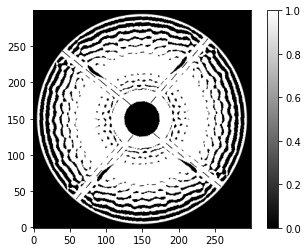

In [64]:
plt.imshow((pupil_rot*apodizer_rot), origin='lower', vmin=0, vmax=1, cmap='gray')
plt.colorbar()

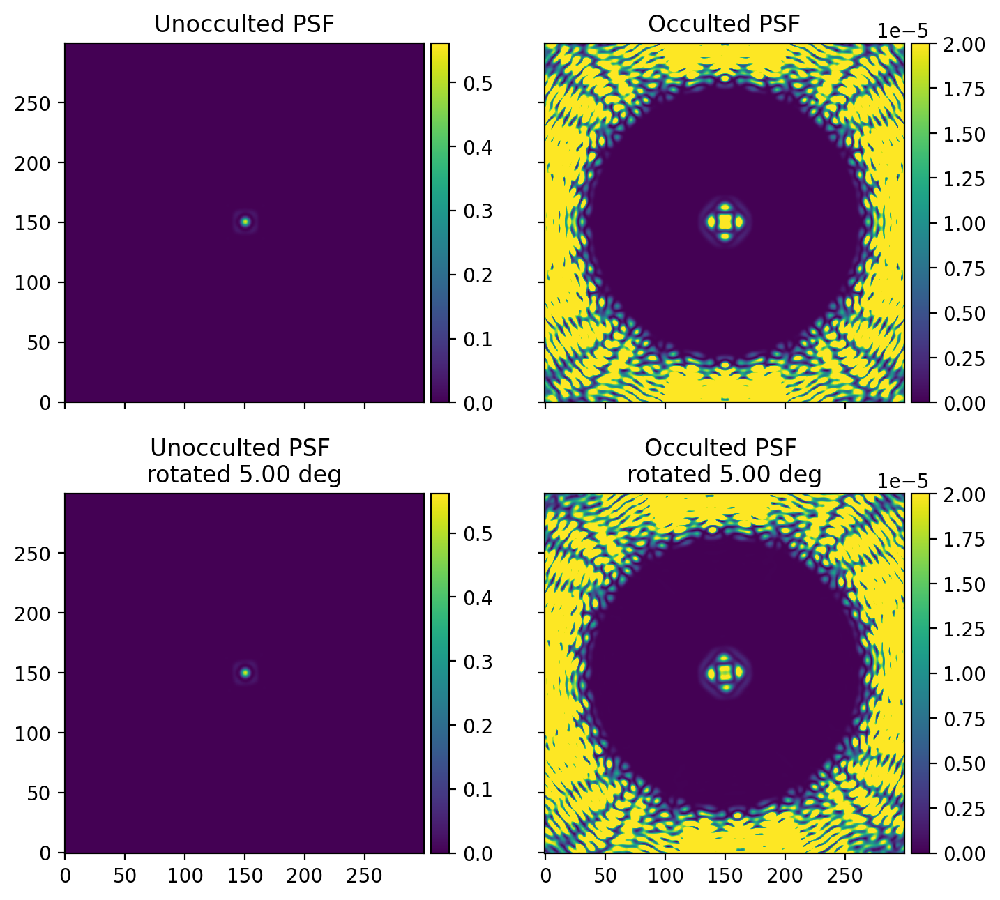

In [65]:
f, ((ax1,ax2),(ax3,ax4)) = plt.subplots(2, 2, figsize=(8,8), dpi=200, sharex=True, sharey=True)

z1 = ax1.imshow(unocc_psf.reshape(300,300), origin='lower', vmin=0)
z2 = ax2.imshow(occ_psf.reshape(300,300), origin='lower', vmin=0, vmax=.00002)
z3 = ax3.imshow(unocc_psf_rot.reshape(300,300), origin='lower', vmin=0)
z4 = ax4.imshow(occ_psf_rot.reshape(300,300), origin='lower', vmin=0, vmax=.00002)

ax1.set_title('Unocculted PSF')
ax2.set_title('Occulted PSF')
ax3.set_title('Unocculted PSF \nrotated {:.2f} deg'.format((pa_rad)*180/np.pi))
ax4.set_title('Occulted PSF \nrotated {:.2f} deg'.format((pa_rad)*180/np.pi))

divider1 = make_axes_locatable(ax1)
cax1 = divider1.append_axes("right", size="5%", pad=0.05)
plt.colorbar(z1,cax=cax1)

divider2 = make_axes_locatable(ax2)
cax2 = divider2.append_axes("right", size="5%", pad=0.05)
plt.colorbar(z2,cax=cax2)

divider3 = make_axes_locatable(ax3)
cax3 = divider3.append_axes("right", size="5%", pad=0.05)
plt.colorbar(z3,cax=cax3)

divider4 = make_axes_locatable(ax4)
cax4 = divider4.append_axes("right", size="5%", pad=0.05)
plt.colorbar(z4,cax=cax4)

plt.subplots_adjust(hspace=.15, wspace=.25)
plt.savefig('plots/broadband_PSF_rotated_5deg.png', dpi=300, bbox_inches='tight')

In [66]:
r, profile, std_profile, n_profile = radial_profile(occ_psf_rot / max(unocc_psf_rot), 0.2)

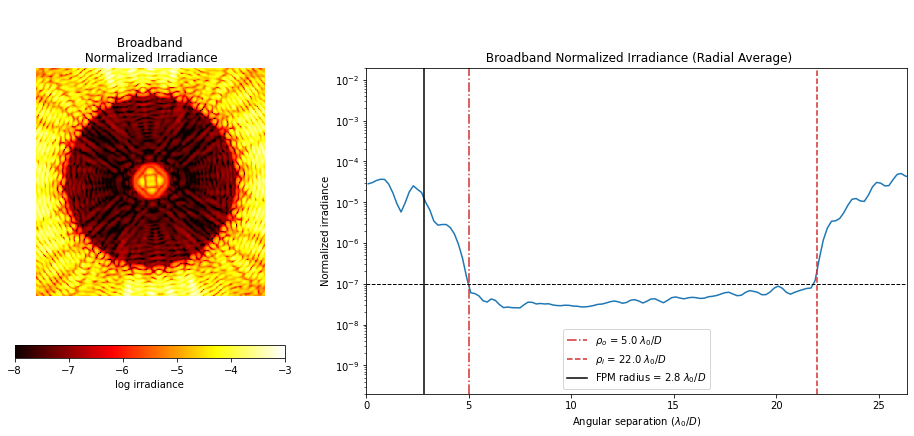

In [67]:
plt.figure(figsize=(16,6))
gs = gridspec.GridSpec(1, 2, width_ratios=[1, 2]) 
plt.subplot(gs[0])
plt.title('\n\n Broadband \n Normalized Irradiance', fontsize=12)
imshow_field(np.log10(occ_psf_rot / max(unocc_psf_rot)), vmin=-contrast - 1, vmax=-contrast + 4, cmap='hot')
cbar = plt.colorbar(orientation='horizontal')
cbar.set_label('log irradiance')
plt.axis('off')
#plt.xlabel('Angular coordinate ($\lambda_0/D$)', fontsize=14)
#plt.ylabel('Angular coordinate ($\lambda_0/D$)', fontsize=14)
plt.tick_params(axis='both', labelsize=8)
plt.subplot(gs[1])
plt.title('\n Broadband Normalized Irradiance (Radial Average)')
plt.plot(r, profile)
iwa_line = plt.axvline(iwa, color=colors.red, linestyle = '-.')
owa_line = plt.axvline(owa, color=colors.red, linestyle = '--')
radius_line = plt.axvline(radius_fpm, color='k')
plt.axhline(10 ** (-contrast), xmin=0, xmax=owa * 1.2, linewidth=1, color='k', linestyle='--')
plt.legend([iwa_line, owa_line, radius_line],
               [r'$\rho_o$ = '+str(float(iwa))+r' $\lambda_0/D$', r'$\rho_i$ = '+str(float(owa))+r' $\lambda_0/D$',
                'FPM radius = '+str(float(radius_fpm))+r' $\lambda_0/D$'])


plt.yscale('log')
plt.xlim(0, owa * 1.2)
plt.ylim(2e-10, 2e-2)
plt.ylabel('Normalized irradiance')
plt.xlabel(r'Angular separation ($\lambda_0/D$)')
plt.savefig('plots/bb_gpi_psf_rot.png', dpi=300, bbox_inches='tight')

### Testing robustness for no aberration with rotated LS/Apodizer 

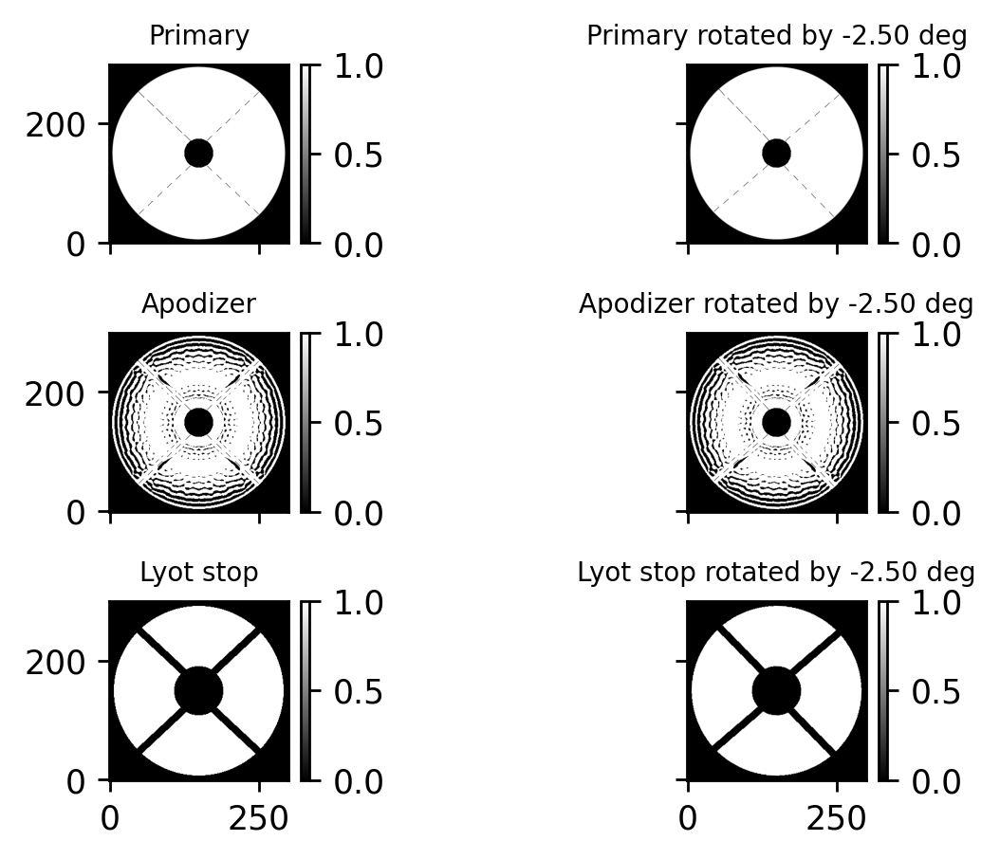

/home/mmnguyen/anaconda3/lib/python3.7/site-packages/hcipy/optics/aberration.py:37: RuntimeWarning: divide by zero encountered in power
  res = Field(grid.as_('polar').r**exponent, grid)


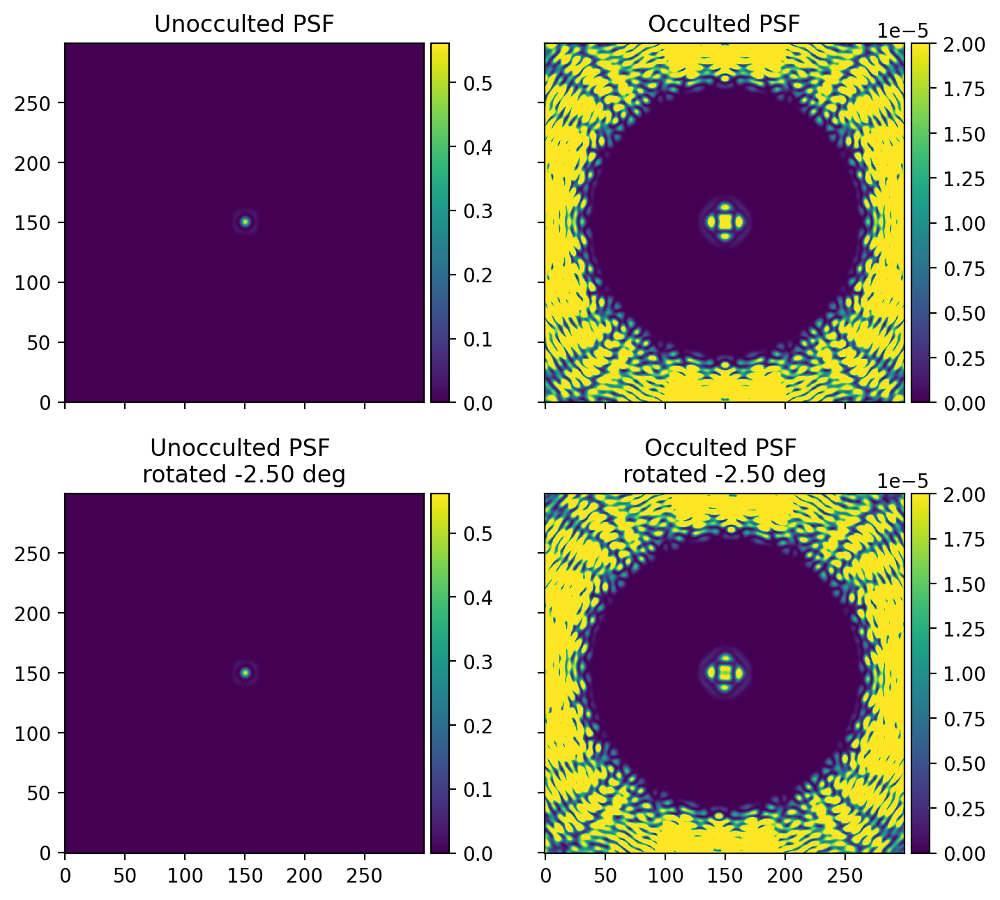

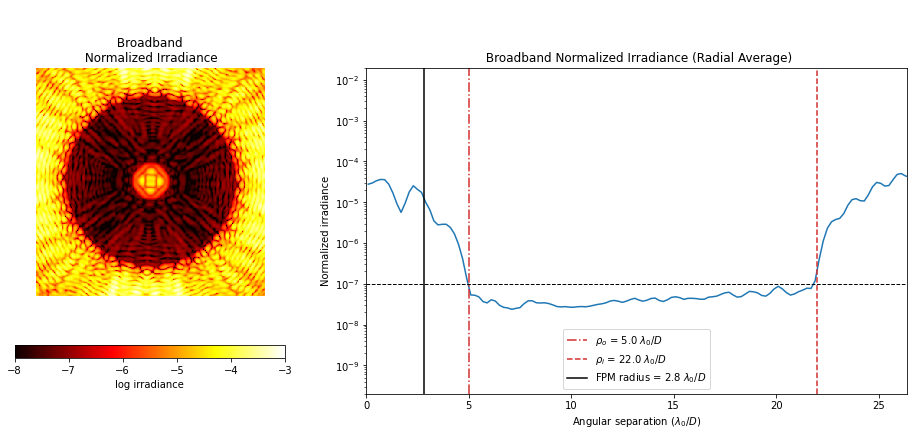

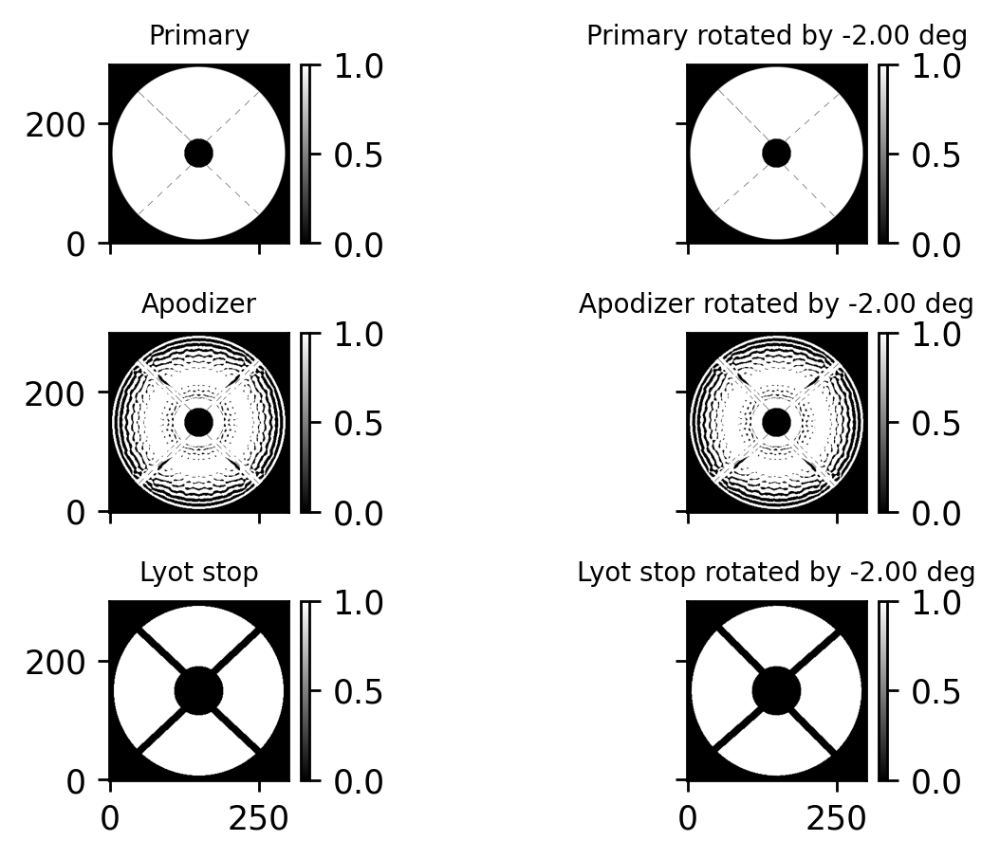

/home/mmnguyen/anaconda3/lib/python3.7/site-packages/hcipy/optics/aberration.py:37: RuntimeWarning: divide by zero encountered in power
  res = Field(grid.as_('polar').r**exponent, grid)


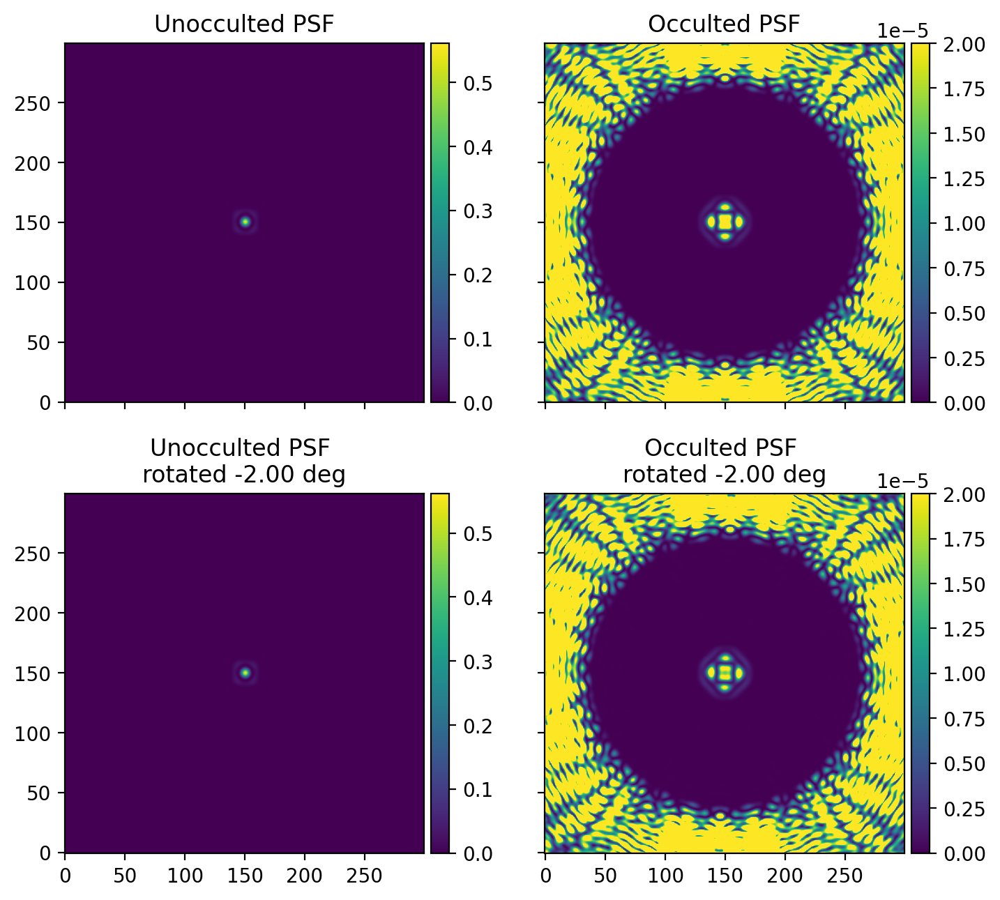

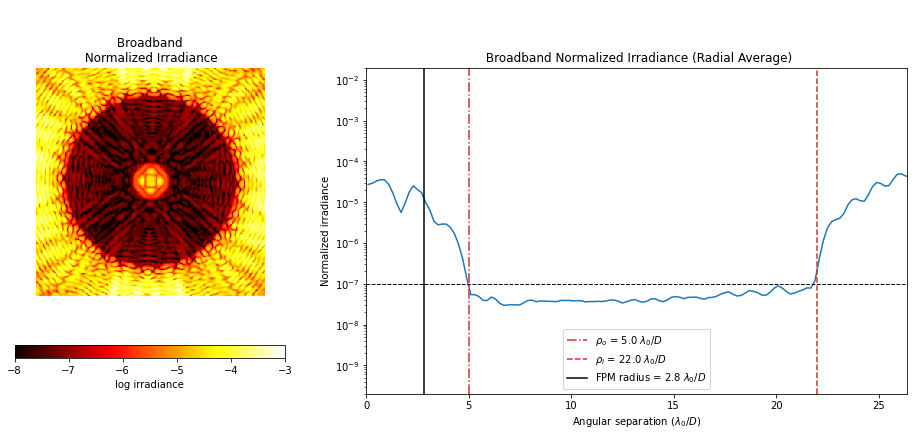

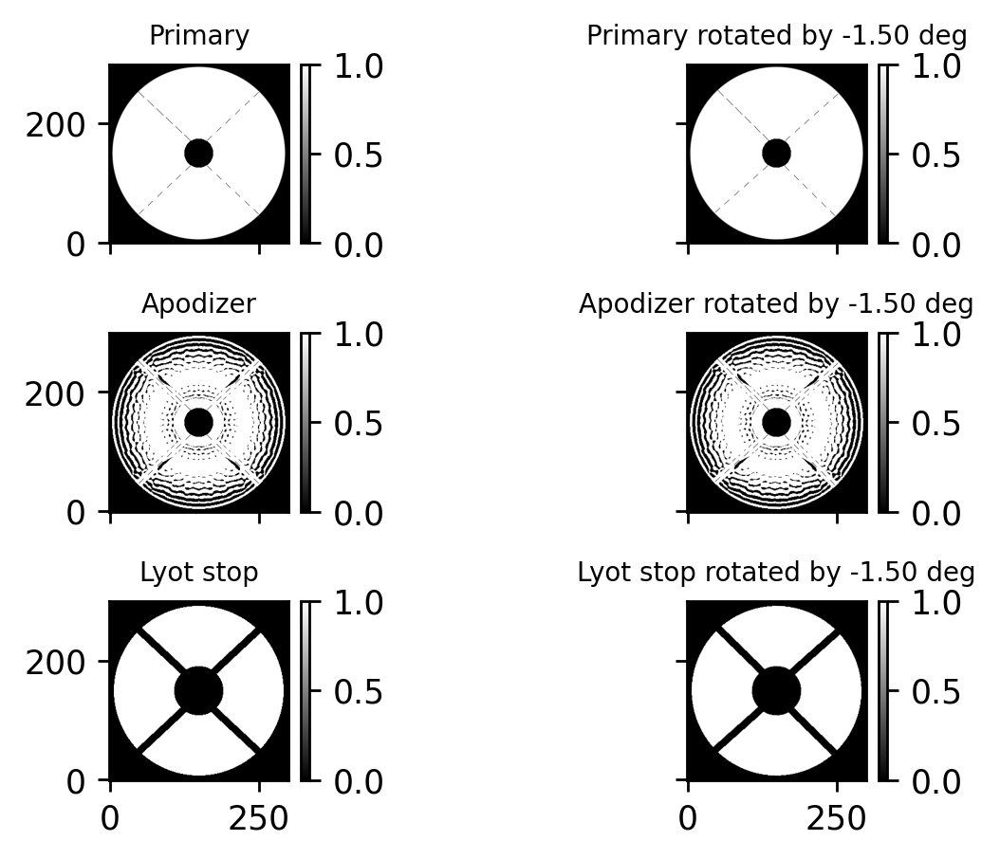

/home/mmnguyen/anaconda3/lib/python3.7/site-packages/hcipy/optics/aberration.py:37: RuntimeWarning: divide by zero encountered in power
  res = Field(grid.as_('polar').r**exponent, grid)


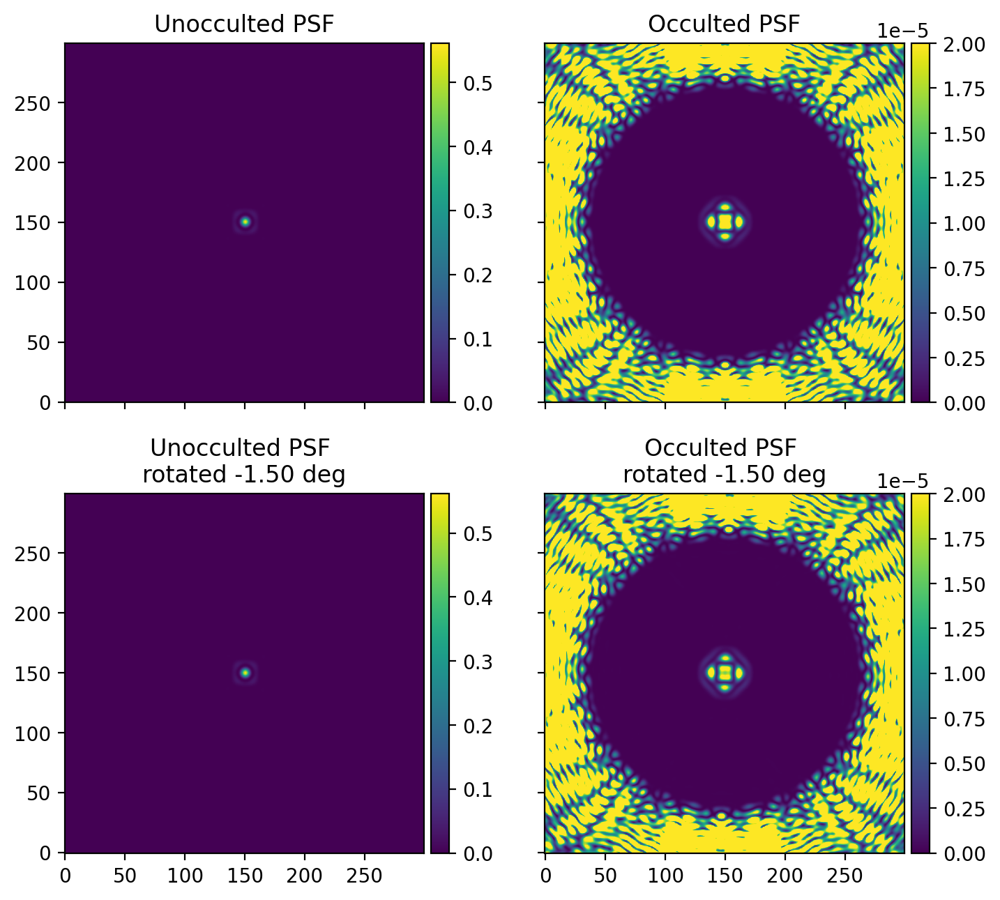

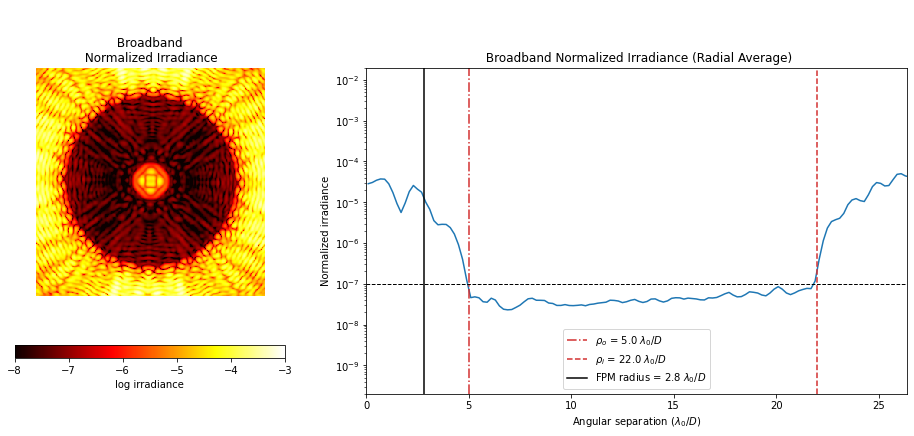

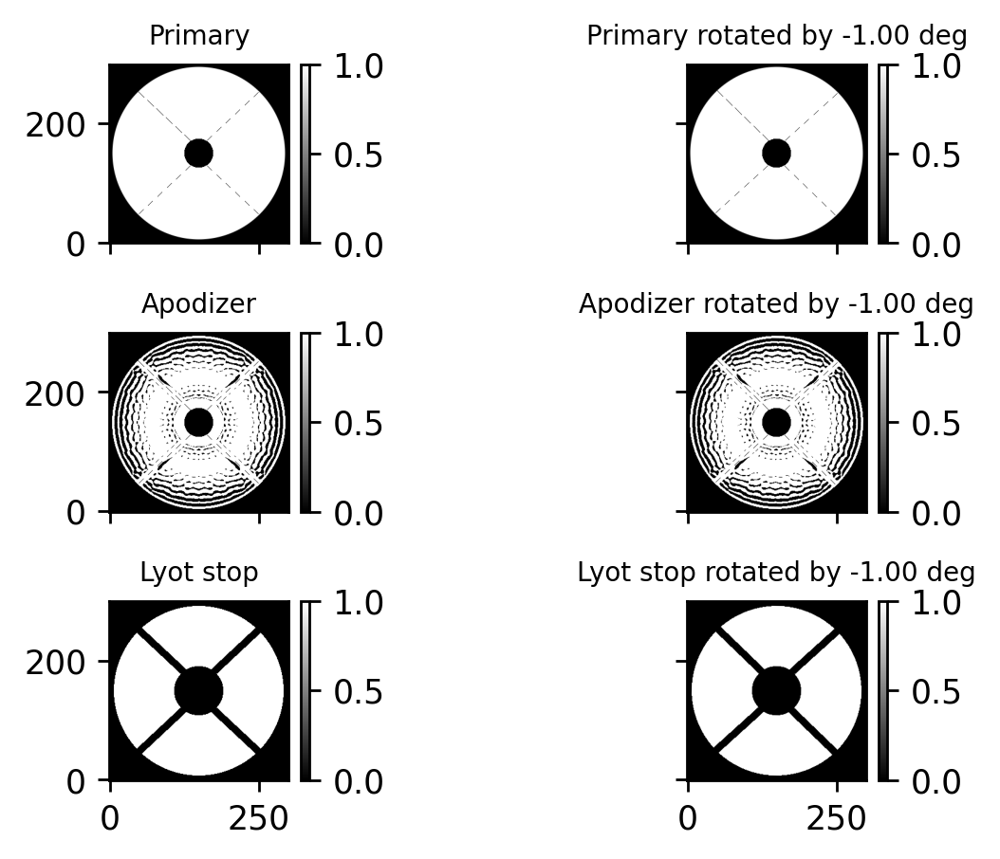

/home/mmnguyen/anaconda3/lib/python3.7/site-packages/hcipy/optics/aberration.py:37: RuntimeWarning: divide by zero encountered in power
  res = Field(grid.as_('polar').r**exponent, grid)


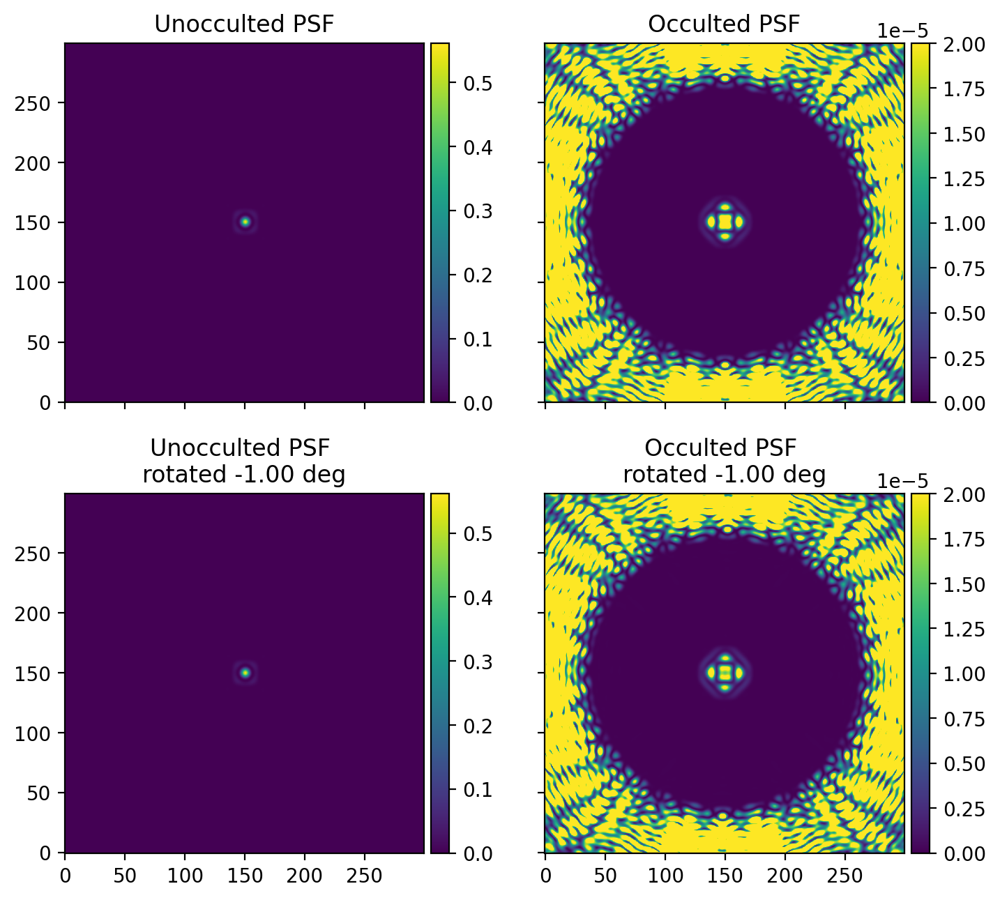

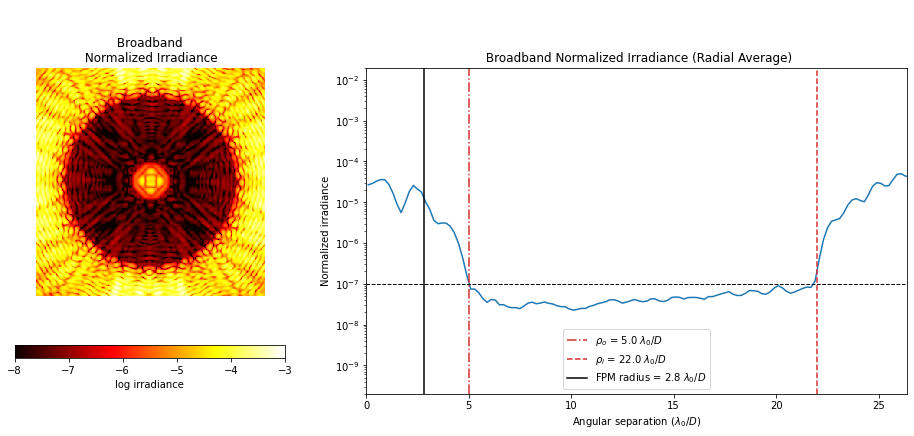

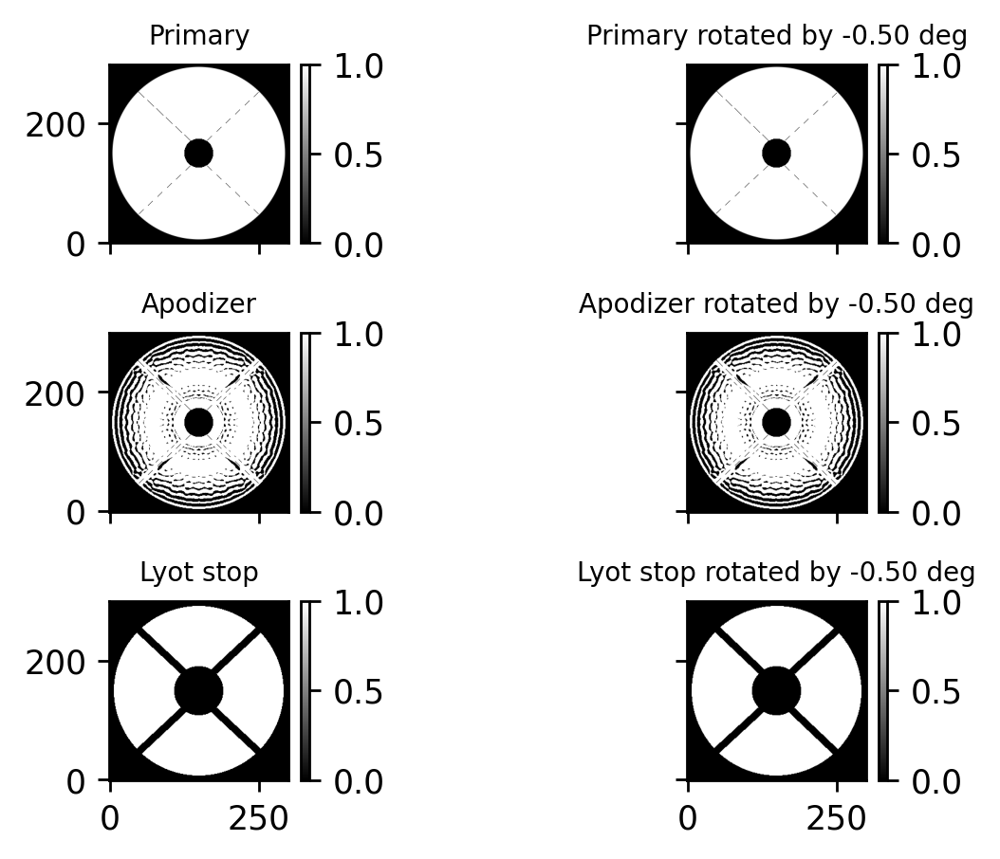

/home/mmnguyen/anaconda3/lib/python3.7/site-packages/hcipy/optics/aberration.py:37: RuntimeWarning: divide by zero encountered in power
  res = Field(grid.as_('polar').r**exponent, grid)


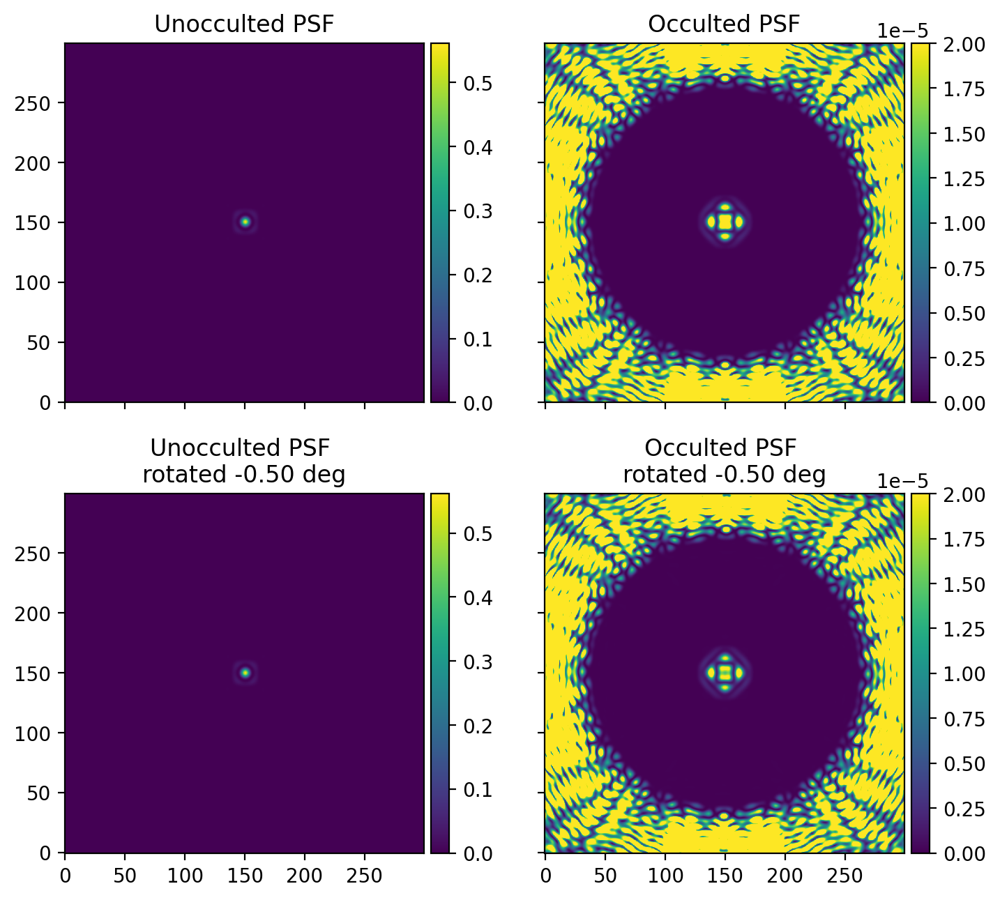

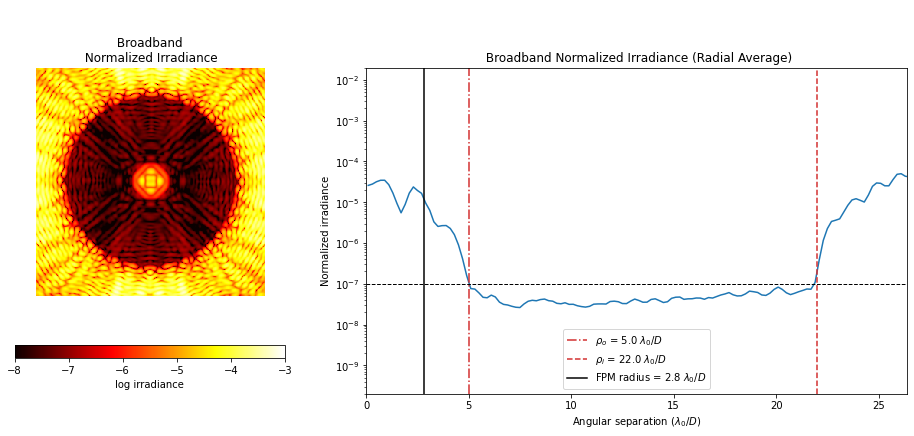

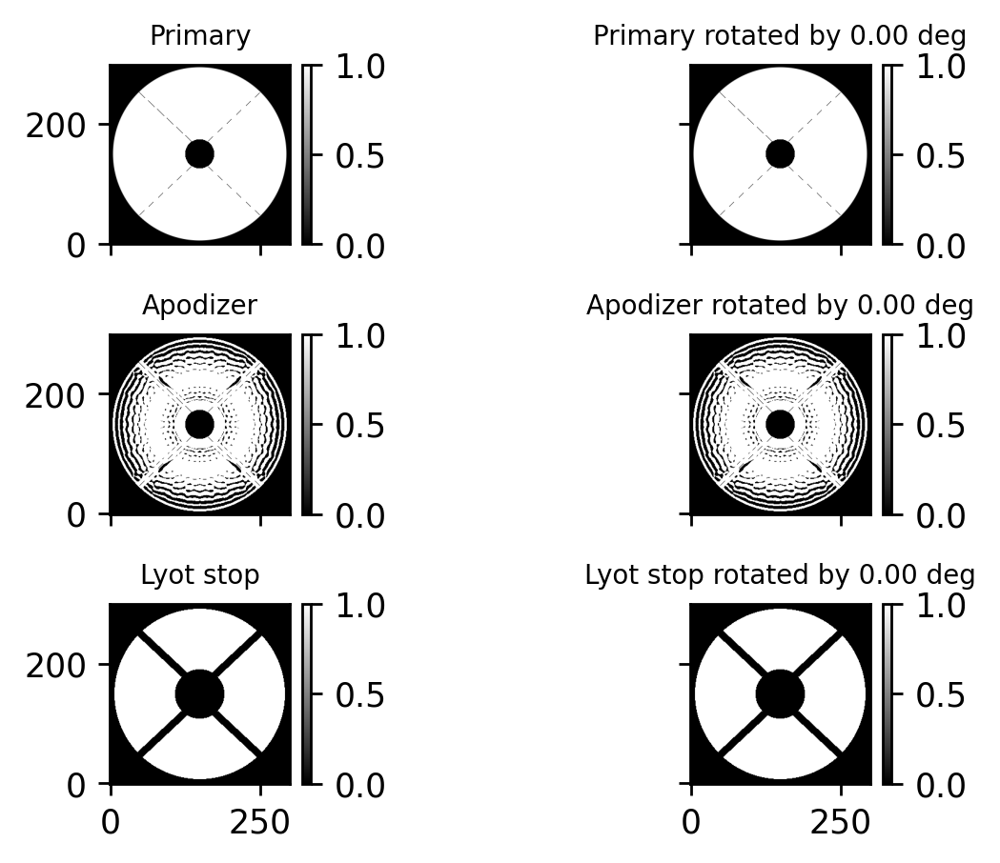

/home/mmnguyen/anaconda3/lib/python3.7/site-packages/hcipy/optics/aberration.py:37: RuntimeWarning: divide by zero encountered in power
  res = Field(grid.as_('polar').r**exponent, grid)


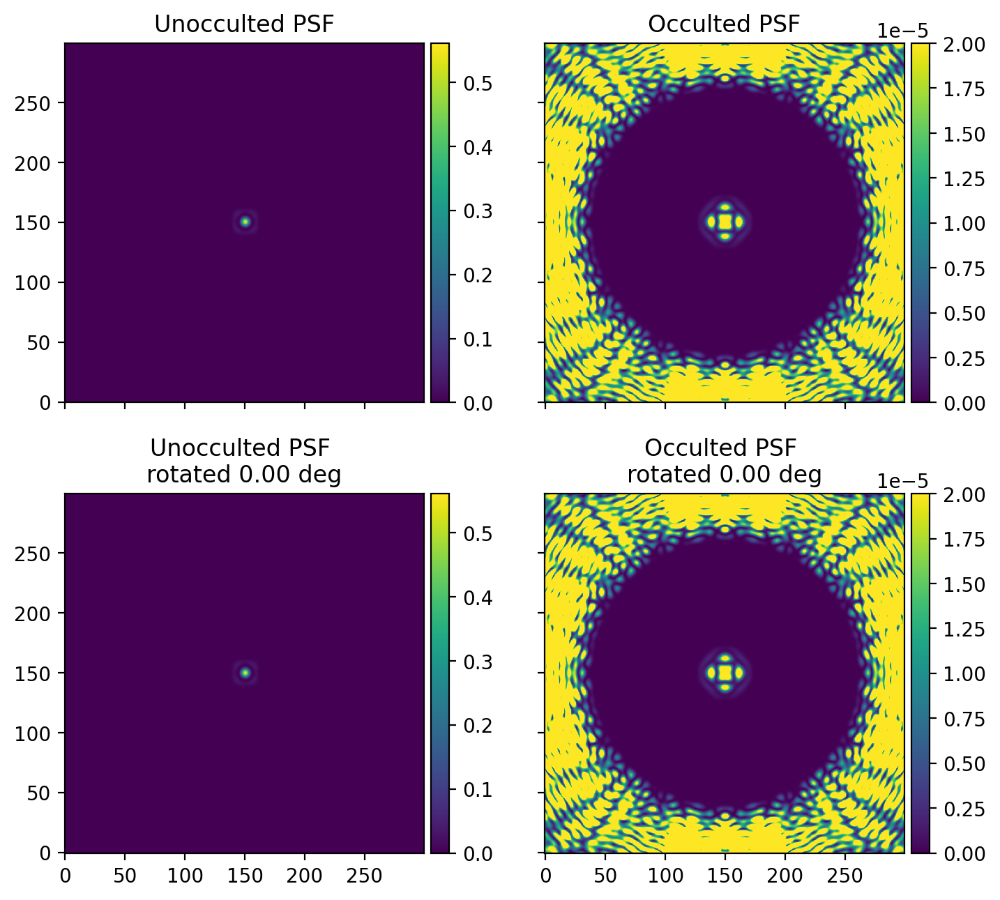

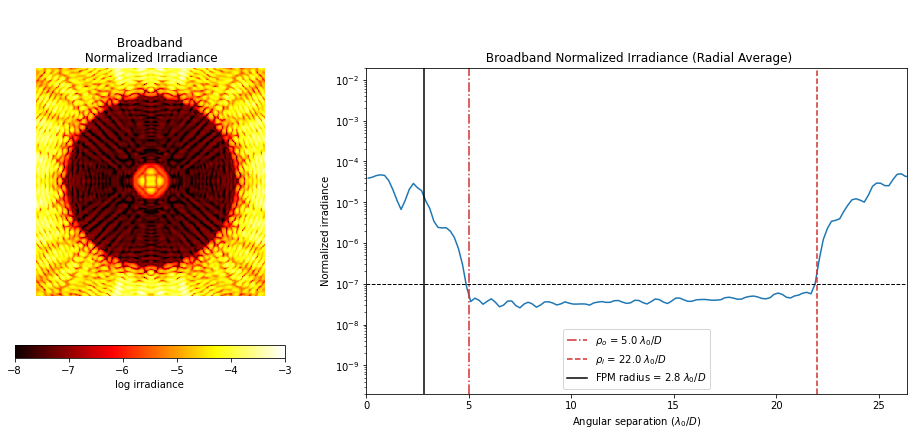

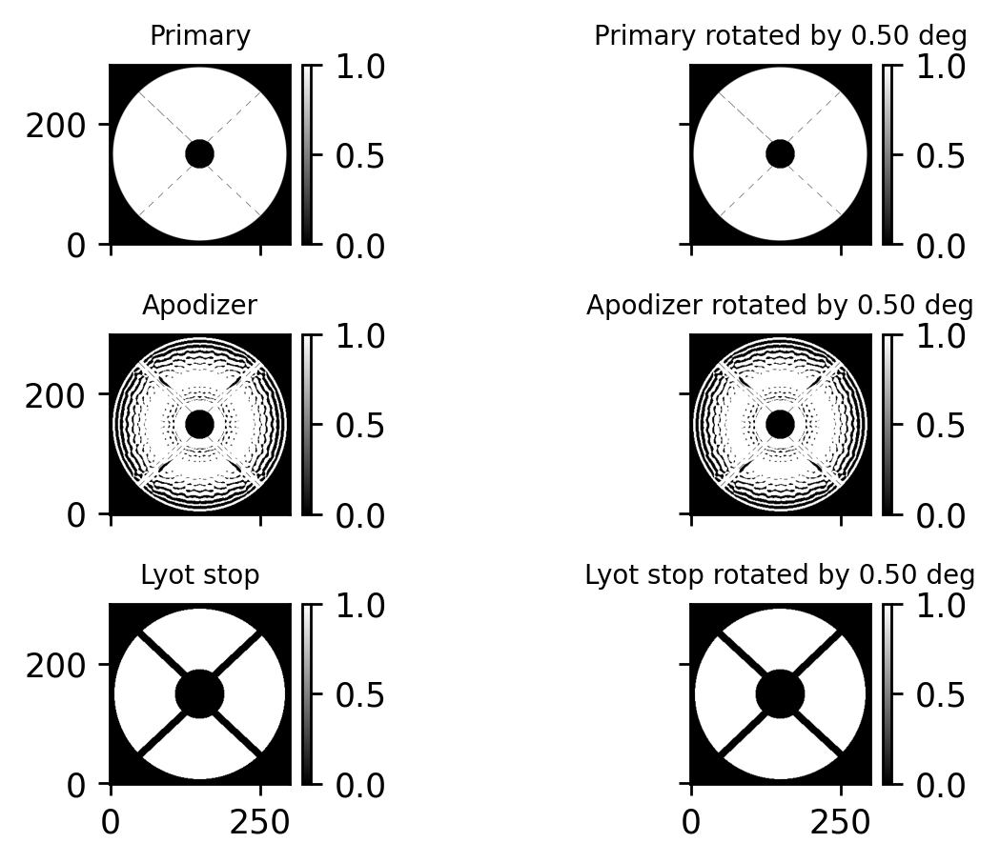

/home/mmnguyen/anaconda3/lib/python3.7/site-packages/hcipy/optics/aberration.py:37: RuntimeWarning: divide by zero encountered in power
  res = Field(grid.as_('polar').r**exponent, grid)


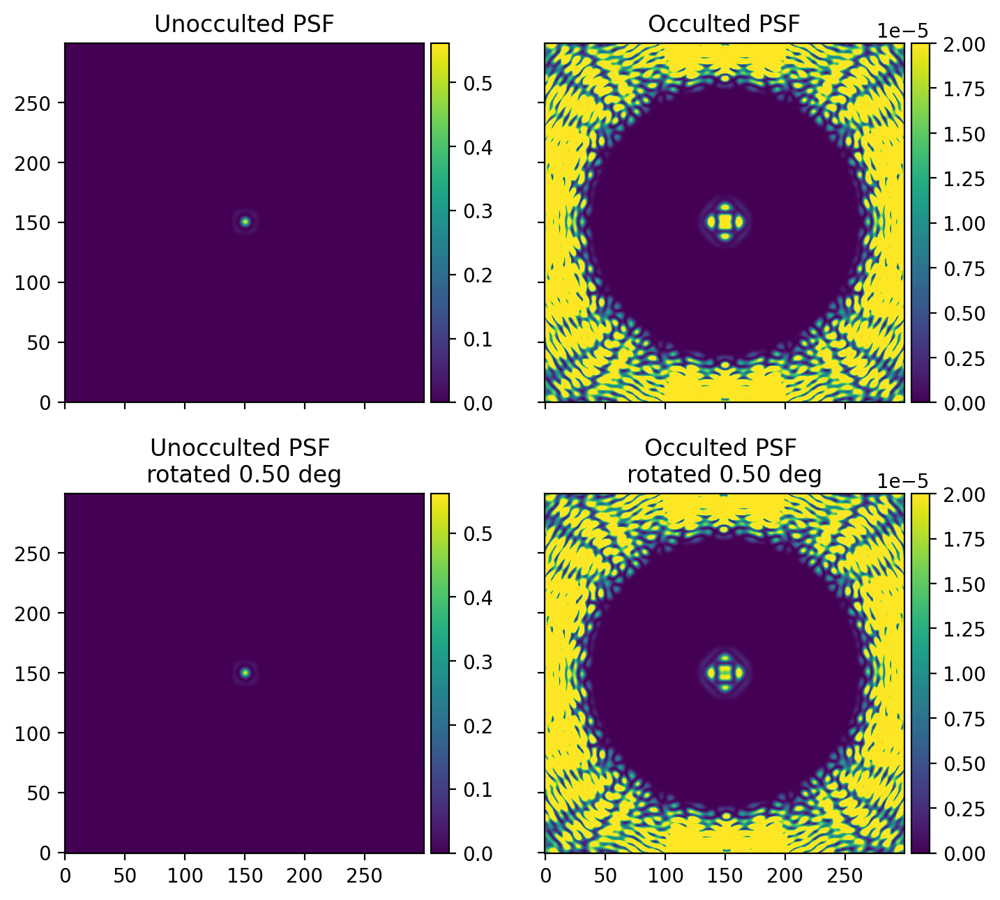

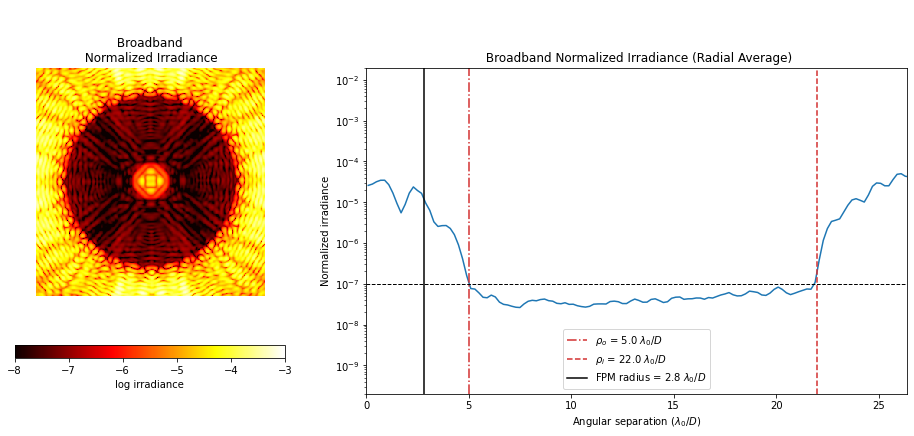

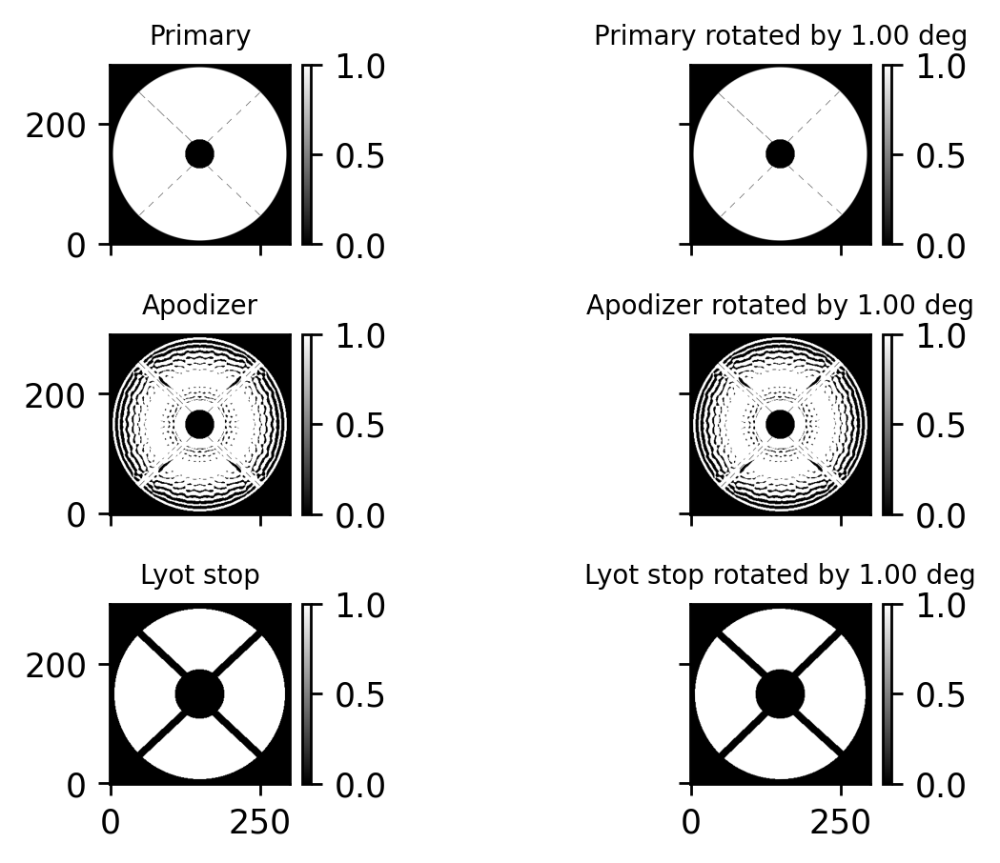

/home/mmnguyen/anaconda3/lib/python3.7/site-packages/hcipy/optics/aberration.py:37: RuntimeWarning: divide by zero encountered in power
  res = Field(grid.as_('polar').r**exponent, grid)


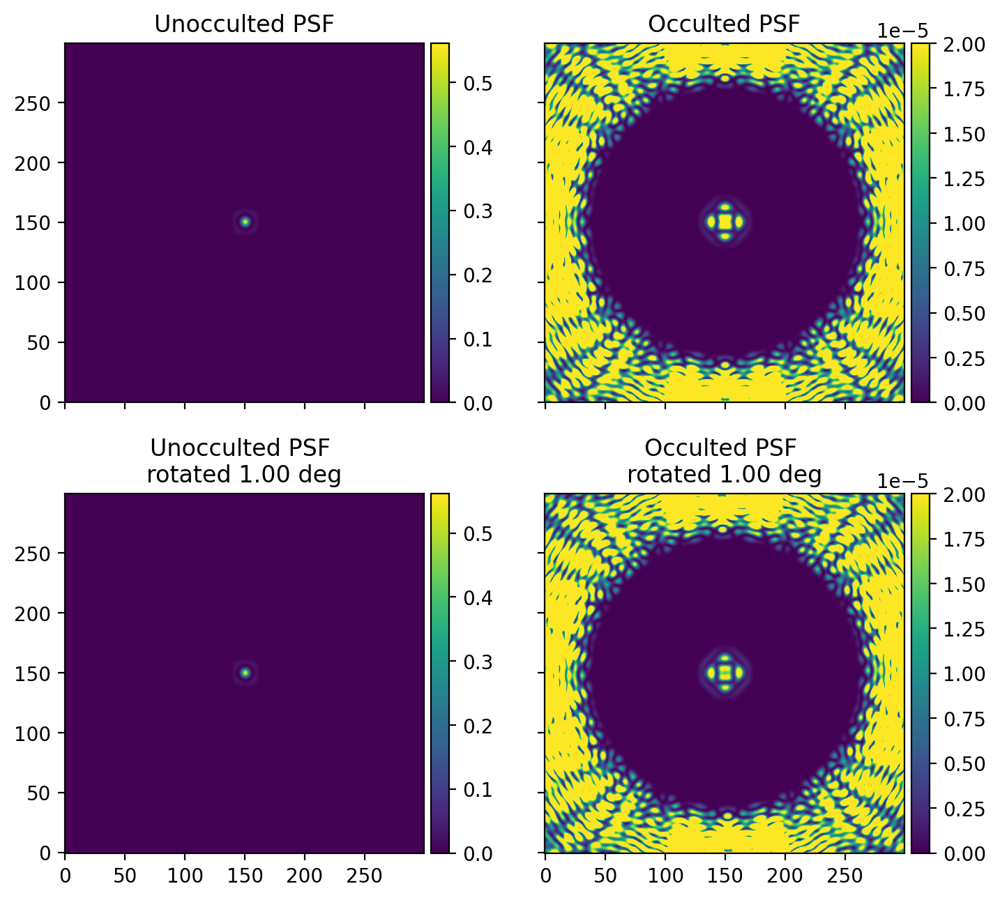

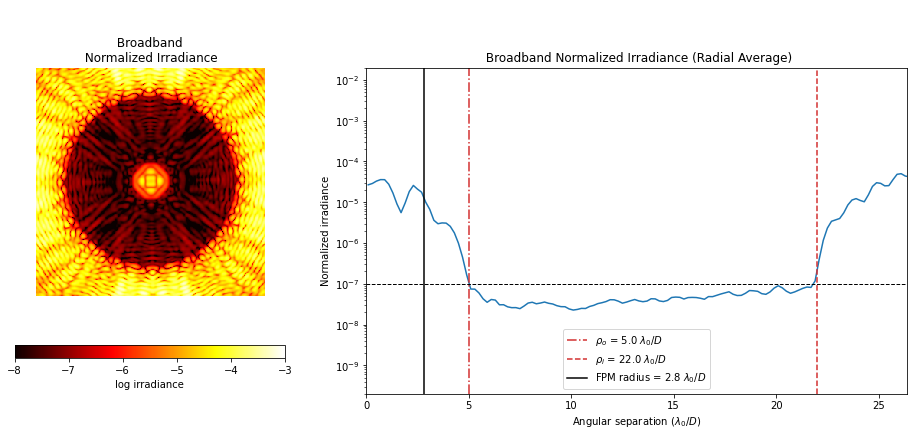

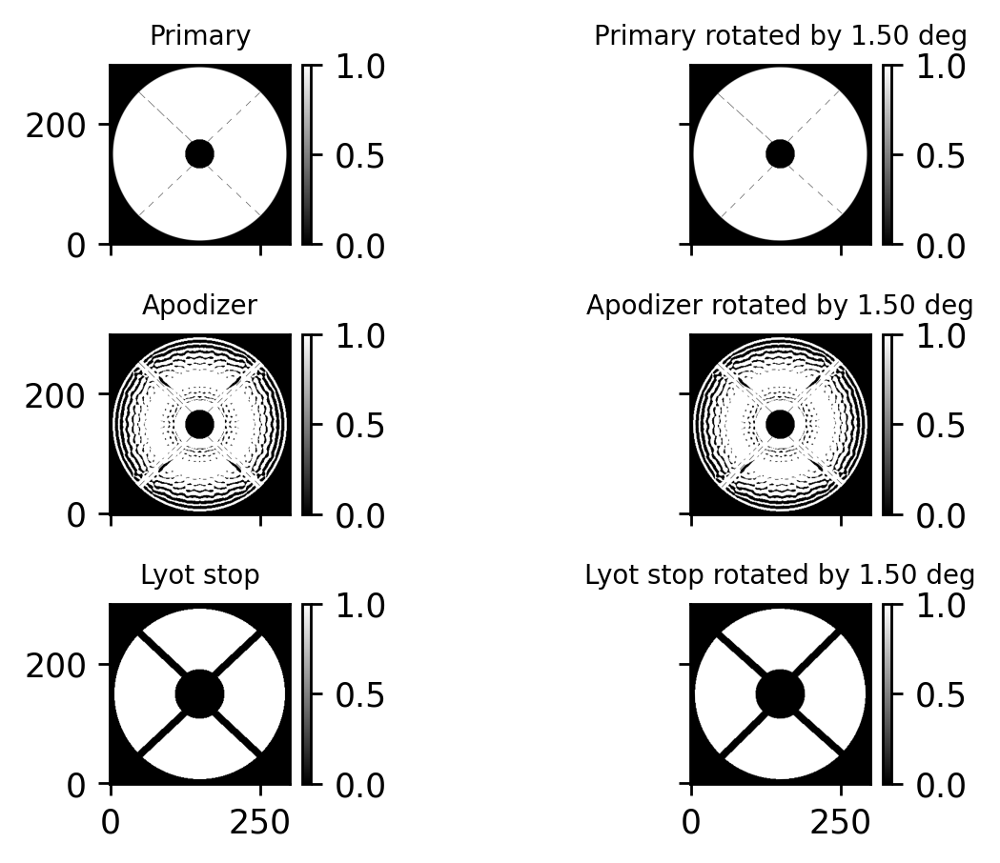

/home/mmnguyen/anaconda3/lib/python3.7/site-packages/hcipy/optics/aberration.py:37: RuntimeWarning: divide by zero encountered in power
  res = Field(grid.as_('polar').r**exponent, grid)


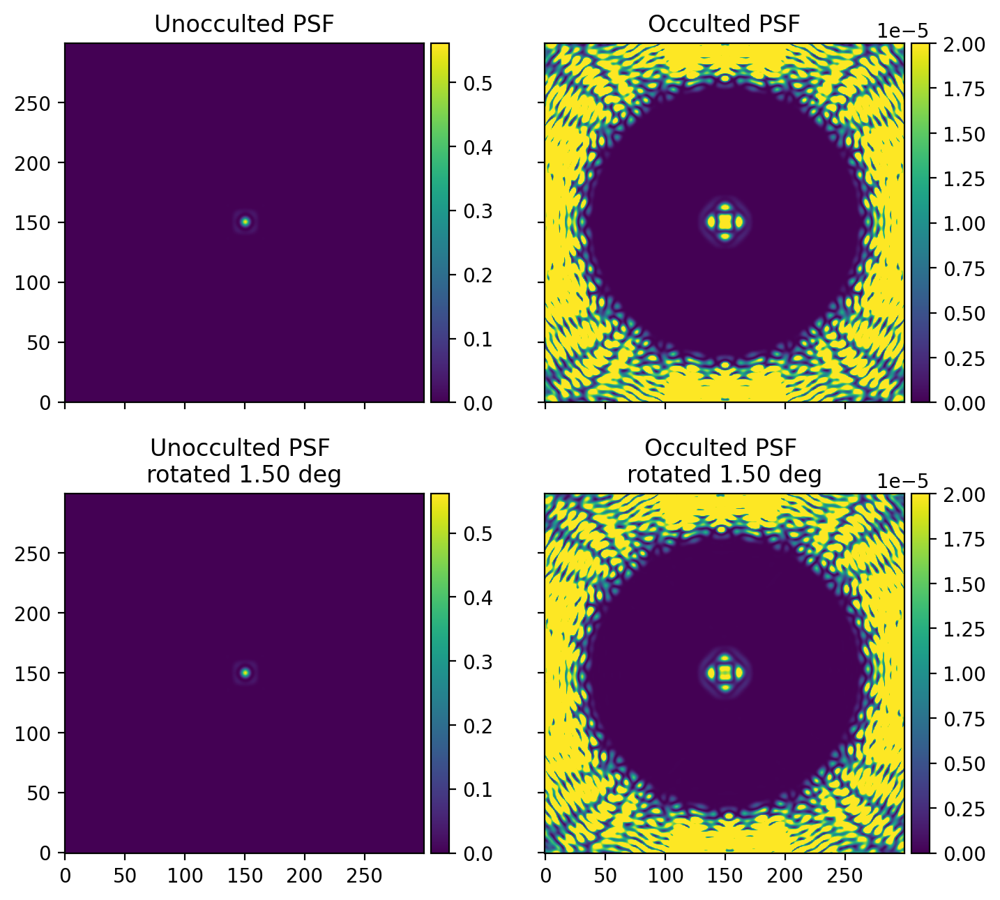

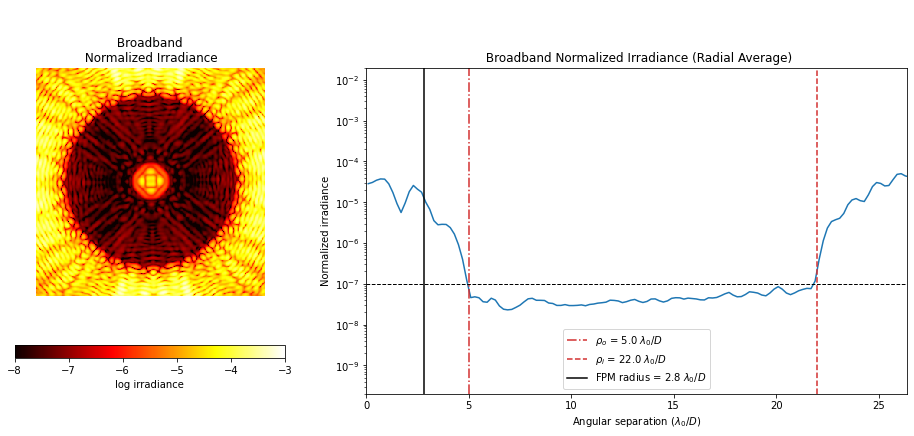

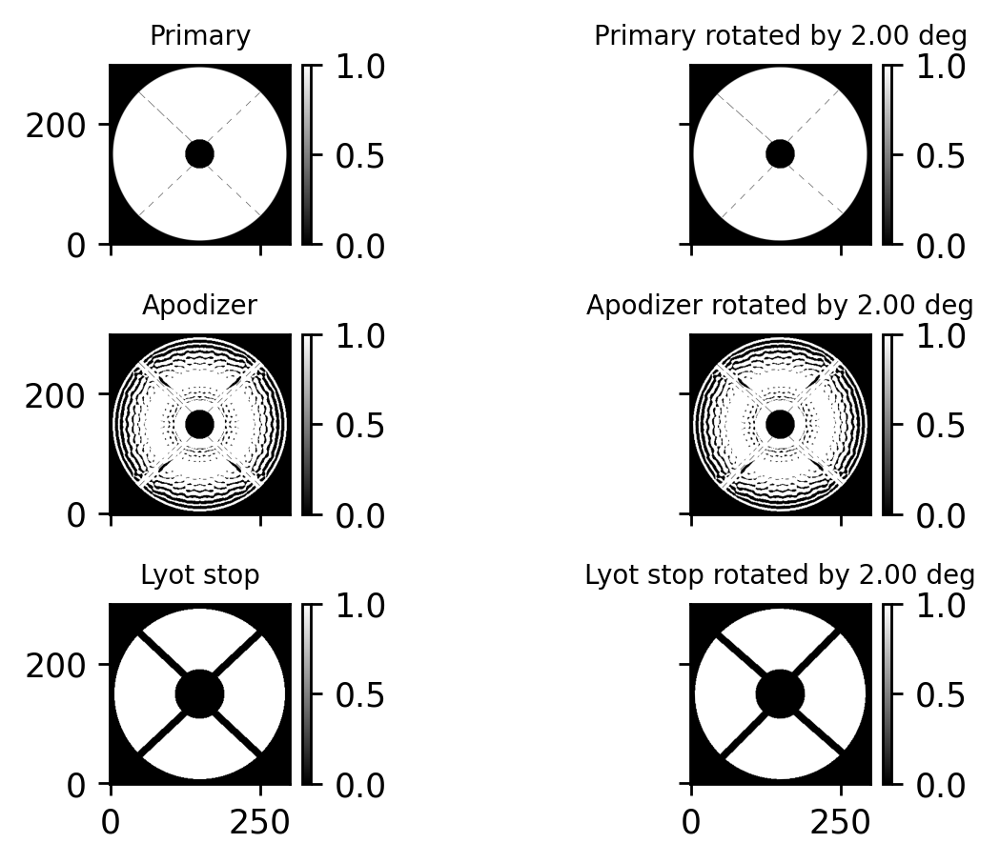

/home/mmnguyen/anaconda3/lib/python3.7/site-packages/hcipy/optics/aberration.py:37: RuntimeWarning: divide by zero encountered in power
  res = Field(grid.as_('polar').r**exponent, grid)


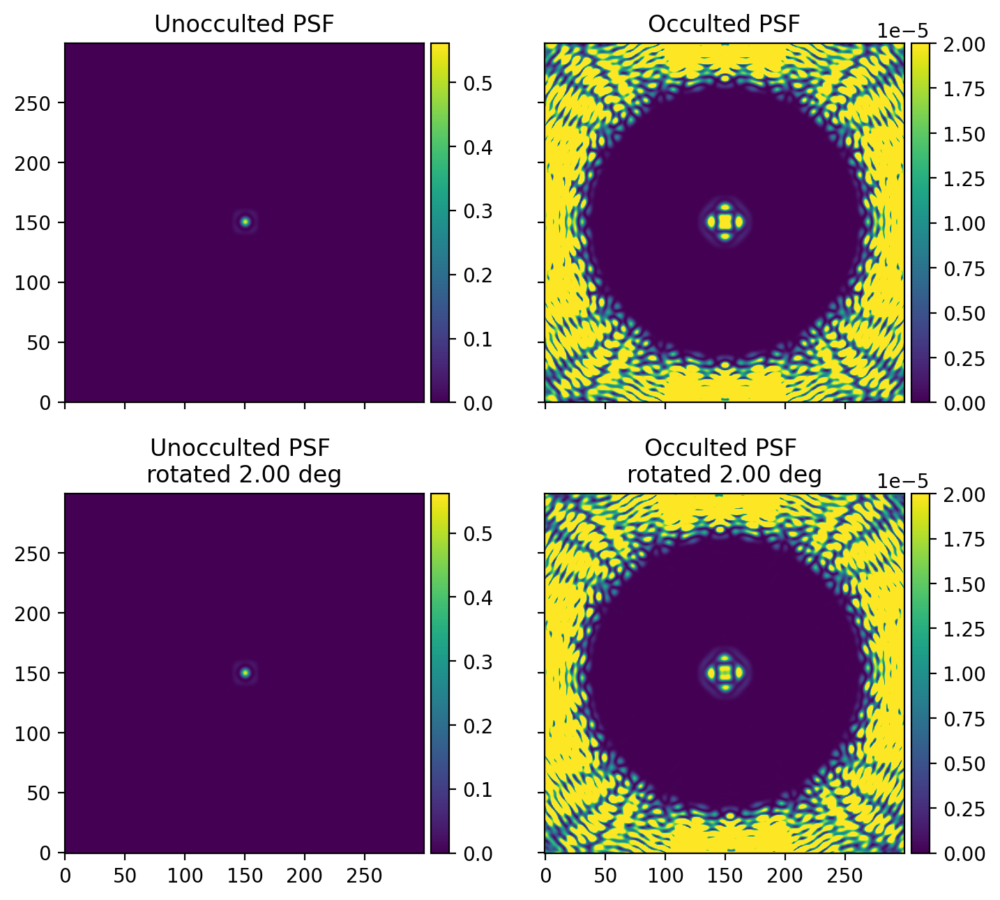

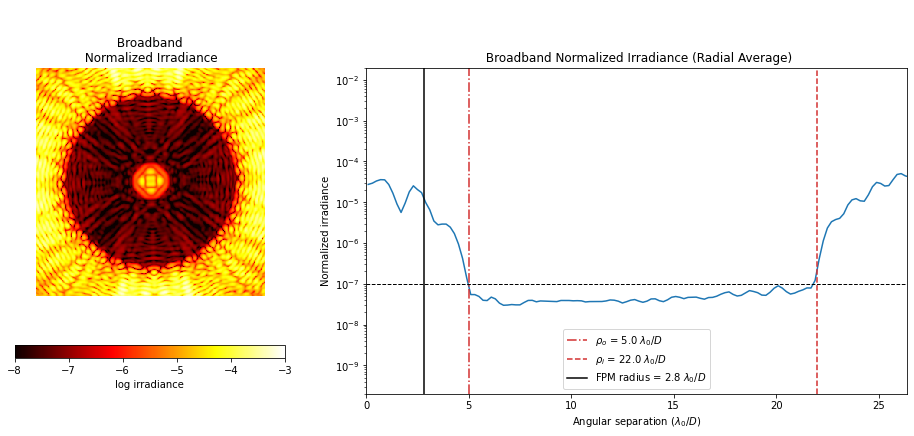

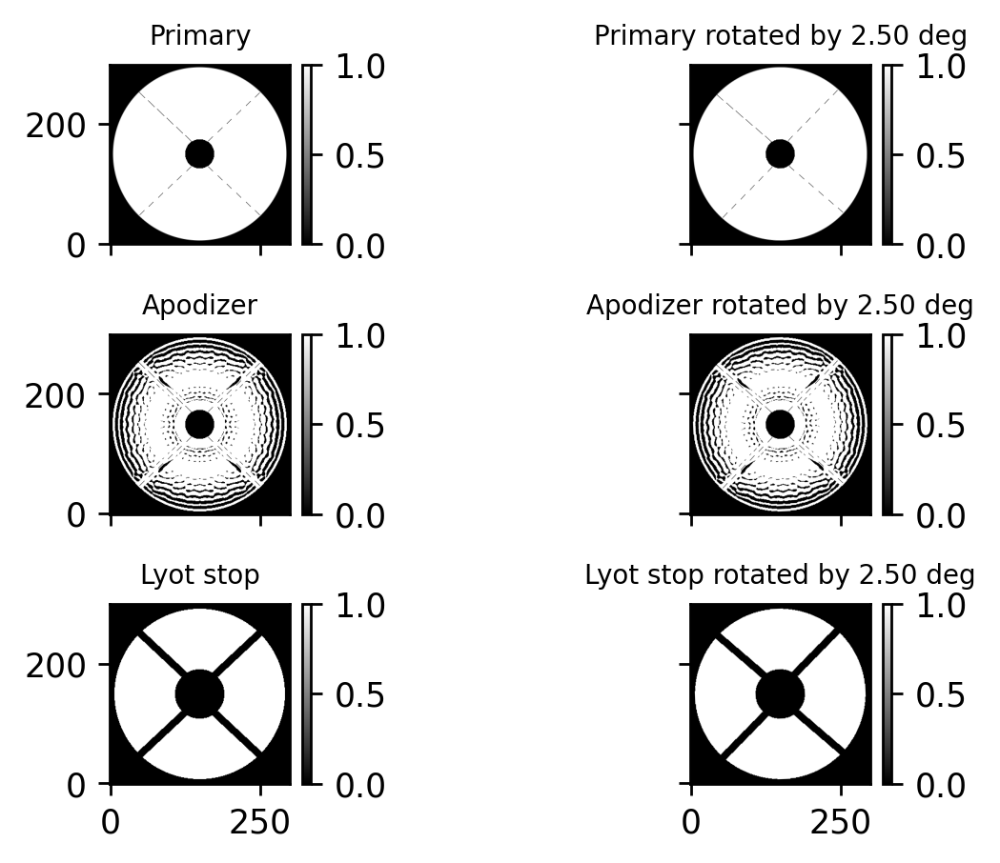

/home/mmnguyen/anaconda3/lib/python3.7/site-packages/hcipy/optics/aberration.py:37: RuntimeWarning: divide by zero encountered in power
  res = Field(grid.as_('polar').r**exponent, grid)


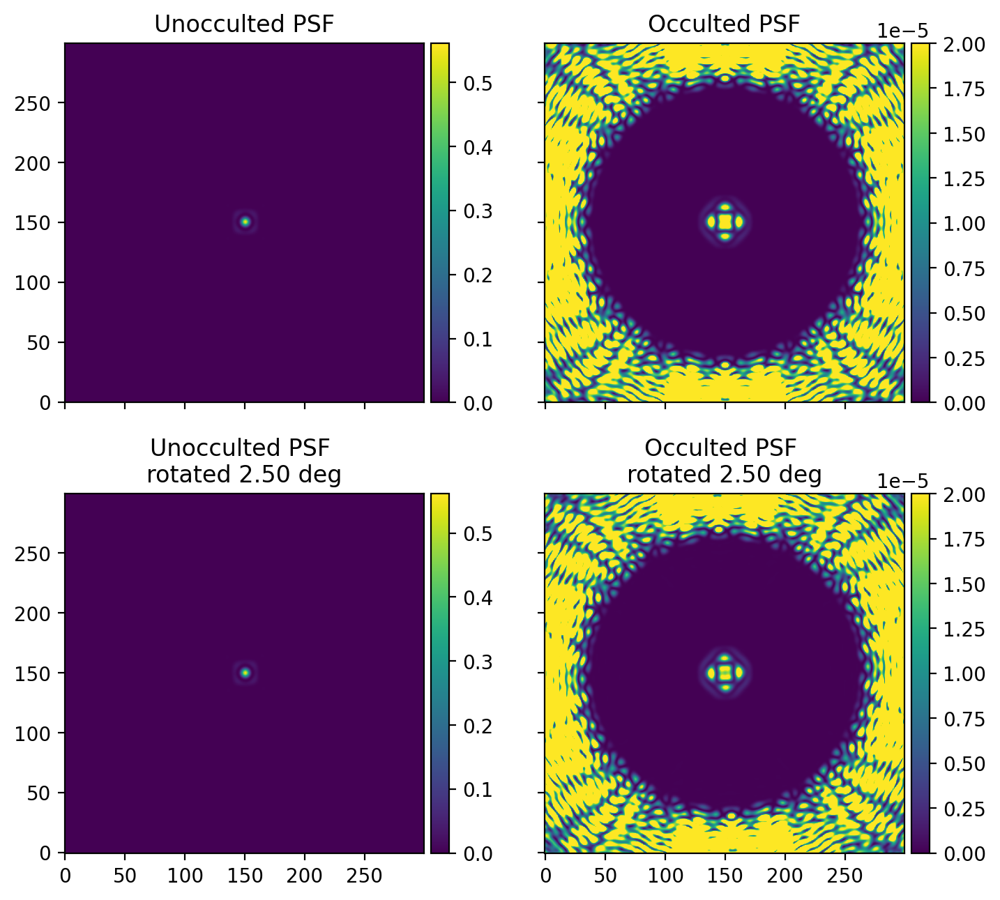

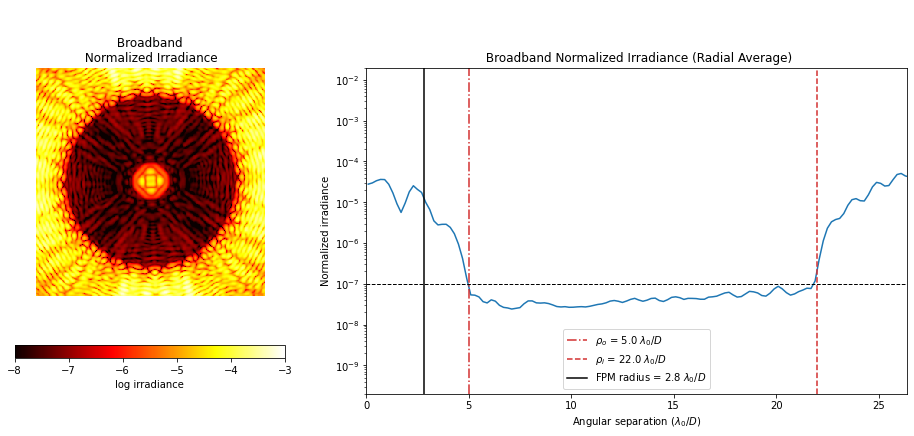

In [58]:
for rot_deg in [-2.5, -2., -1.5, -1., -.5, 0, .5, 1., 1.5, 2., 2.5]:

    rotated = []

    pupil_rot = pupil.copy().reshape(300,300)
    apodizer_rot = apodizer.copy().reshape(300,300)
    lyot_stop_rot = lyot_stop.copy().reshape(300,300)
    rot_rad = rot_deg*np.pi/180

    # Use map coordinates to rotate
    x, y = np.meshgrid(np.arange(300, dtype=np.float64), np.arange(300, dtype=np.float64))
    centx, centy = 149, 149
    # dx, dy = 0, 0
    # x -= dx
    # y -= dy
    xp = (x-centx)*np.cos(rot_rad) + (y-centy)*np.sin(rot_rad) + centx
    yp = -(x-centx)*np.sin(rot_rad) + (y-centy)*np.cos(rot_rad) + centy

    pupil_rot = map_coordinates(pupil_rot, (yp, xp), cval=0)
    apodizer_rot = map_coordinates(apodizer_rot, (yp, xp), cval=0)
    lyot_stop_rot = map_coordinates(lyot_stop_rot, (yp, xp), cval=0)
    
    
    # Plotting the rotations of the different components (primary, apodizer, LS)
    f, ((ax0, ax1), (ax2, ax3), (ax4, ax5)) = plt.subplots(3, 2, sharex=True, sharey=True, dpi=250)
    ax0.set_title('Primary', fontsize=8)
    z0 = ax0.imshow(pupil.reshape(300,300), cmap='gray', origin='lower', vmin=0, vmax=1)
    divider = make_axes_locatable(ax0)
    cax0 = divider.append_axes('right', size='5%', pad=0.05)
    plt.colorbar(z0, cax=cax0)

    ax1.set_title('Primary rotated by {:.2f} deg'.format((rot_rad)*180/np.pi), fontsize=8)
    z1 = ax1.imshow(pupil_rot, cmap='gray', origin='lower', vmin=0, vmax=1)
    divider = make_axes_locatable(ax1)
    cax1 = divider.append_axes('right', size='5%', pad=0.05)
    plt.colorbar(z1, cax=cax1)

    ax2.set_title('Apodizer', fontsize=8)
    z2 = ax2.imshow(apodizer.reshape(300,300), cmap='gray', origin='lower', vmin=0, vmax=1)
    divider = make_axes_locatable(ax2)
    cax2 = divider.append_axes('right', size='5%', pad=0.05)
    plt.colorbar(z2, cax=cax2)

    ax3.set_title('Apodizer rotated by {:.2f} deg'.format((rot_rad)*180/np.pi), fontsize=8)
    z3 = ax3.imshow(apodizer_rot, cmap='gray', origin='lower', vmin=0, vmax=1)
    divider = make_axes_locatable(ax3)
    cax3 = divider.append_axes('right', size='5%', pad=0.05)
    plt.colorbar(z3, cax=cax3)

    ax4.set_title('Lyot stop', fontsize=8)
    z4 = ax4.imshow(lyot_stop.reshape(300,300), cmap='gray', origin='lower', vmin=0, vmax=1)
    divider = make_axes_locatable(ax4)
    cax4 = divider.append_axes('right', size='5%', pad=0.05)
    plt.colorbar(z4, cax=cax4)

    ax5.set_title('Lyot stop rotated by {:.2f} deg'.format((rot_rad)*180/np.pi), fontsize=8)
    z5 = ax5.imshow(lyot_stop_rot, cmap='gray', origin='lower', vmin=0, vmax=1)
    divider = make_axes_locatable(ax5)
    cax5 = divider.append_axes('right', size='5%', pad=0.05)
    plt.colorbar(z5, cax=cax5)
    plt.subplots_adjust(wspace=.1, hspace=.5)
    plt.show()
    plt.close()
    
    # Now running the analysis
    pupil_grid = hcipy.make_pupil_grid(300)
    
    pupil_rot = Field(pupil_rot, pupil_grid)
    apodizer_rot = Field(apodizer_rot, pupil_grid)
    
    broadband_results_rot = calc_psf((pupil_rot*apodizer_rot).ravel(), .2, 1, 3, lyot_stop_rot.ravel(), focal_plane_mask)
    
    unocc_psf_rot = broadband_results_rot['unocculted_psf']
    occ_psf_rot = broadband_results_rot['occulted_psf']
    unocc_psf_ab_rot = broadband_results_rot['unocculted_psf_ab']
    occ_psf_ab_rot = broadband_results_rot['occulted_psf_ab']
    
    f, ((ax1,ax2),(ax3,ax4)) = plt.subplots(2, 2, figsize=(8,8), dpi=200, sharex=True, sharey=True)

    z1 = ax1.imshow(unocc_psf.reshape(300,300), origin='lower', vmin=0)
    z2 = ax2.imshow(occ_psf.reshape(300,300), origin='lower', vmin=0, vmax=.00002)
    z3 = ax3.imshow(unocc_psf_rot.reshape(300,300), origin='lower', vmin=0)
    z4 = ax4.imshow(occ_psf_rot.reshape(300,300), origin='lower', vmin=0, vmax=.00002)

    ax1.set_title('Unocculted PSF')
    ax2.set_title('Occulted PSF')
    ax3.set_title('Unocculted PSF \nrotated {:.2f} deg'.format((rot_rad)*180/np.pi))
    ax4.set_title('Occulted PSF \nrotated {:.2f} deg'.format((rot_rad)*180/np.pi))

    divider1 = make_axes_locatable(ax1)
    cax1 = divider1.append_axes("right", size="5%", pad=0.05)
    plt.colorbar(z1,cax=cax1)

    divider2 = make_axes_locatable(ax2)
    cax2 = divider2.append_axes("right", size="5%", pad=0.05)
    plt.colorbar(z2,cax=cax2)

    divider3 = make_axes_locatable(ax3)
    cax3 = divider3.append_axes("right", size="5%", pad=0.05)
    plt.colorbar(z3,cax=cax3)

    divider4 = make_axes_locatable(ax4)
    cax4 = divider4.append_axes("right", size="5%", pad=0.05)
    plt.colorbar(z4,cax=cax4)

    plt.subplots_adjust(hspace=.15, wspace=.25)
    plt.savefig('plots/broadband_PSF_rotated_{}deg.png'.format(rot_deg), dpi=300, bbox_inches='tight')
    plt.show()
    plt.close()
    
    r, profile, std_profile, n_profile = radial_profile(occ_psf_rot / max(unocc_psf_rot), 0.2)
    
    plt.figure(figsize=(16,6))
    gs = gridspec.GridSpec(1, 2, width_ratios=[1, 2]) 
    plt.subplot(gs[0])
    plt.title('\n\n Broadband \n Normalized Irradiance', fontsize=12)
    imshow_field(np.log10(occ_psf_rot / max(unocc_psf_rot)), vmin=-contrast - 1, vmax=-contrast + 4, cmap='hot')
    cbar = plt.colorbar(orientation='horizontal')
    cbar.set_label('log irradiance')
    plt.axis('off')
    #plt.xlabel('Angular coordinate ($\lambda_0/D$)', fontsize=14)
    #plt.ylabel('Angular coordinate ($\lambda_0/D$)', fontsize=14)
    plt.tick_params(axis='both', labelsize=8)
    plt.subplot(gs[1])
    plt.title('\n Broadband Normalized Irradiance (Radial Average)')
    plt.plot(r, profile)
    iwa_line = plt.axvline(iwa, color=colors.red, linestyle = '-.')
    owa_line = plt.axvline(owa, color=colors.red, linestyle = '--')
    radius_line = plt.axvline(radius_fpm, color='k')
    plt.axhline(10 ** (-contrast), xmin=0, xmax=owa * 1.2, linewidth=1, color='k', linestyle='--')
    plt.legend([iwa_line, owa_line, radius_line],
                   [r'$\rho_o$ = '+str(float(iwa))+r' $\lambda_0/D$', r'$\rho_i$ = '+str(float(owa))+r' $\lambda_0/D$',
                    'FPM radius = '+str(float(radius_fpm))+r' $\lambda_0/D$'])


    plt.yscale('log')
    plt.xlim(0, owa * 1.2)
    plt.ylim(2e-10, 2e-2)
    plt.ylabel('Normalized irradiance')
    plt.xlabel(r'Angular separation ($\lambda_0/D$)')
    plt.savefig('plots/bb_gpi_psf_rotated_{}deg.png', dpi=300, bbox_inches='tight')
    plt.show()
    plt.close()

### No aberration

In [134]:
r, profile, std_profile, n_profile = radial_profile(occ_psf / max(unocc_psf), 0.2)

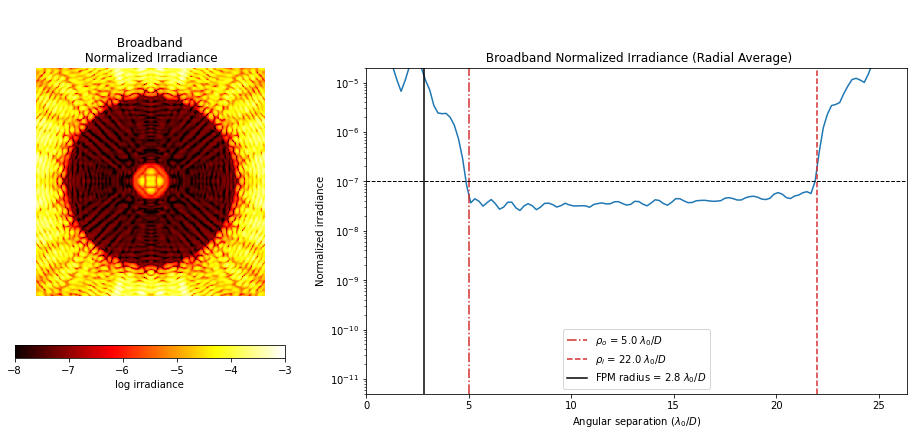

In [135]:
plt.figure(figsize=(16,6))
gs = gridspec.GridSpec(1, 2, width_ratios=[1, 2]) 
plt.subplot(gs[0])
plt.title('\n\n Broadband \n Normalized Irradiance', fontsize=12)
imshow_field(np.log10(occ_psf / max(unocc_psf)), vmin=-contrast - 1, vmax=-contrast + 4, cmap='hot')
cbar = plt.colorbar(orientation='horizontal')
cbar.set_label('log irradiance')
plt.axis('off')
#plt.xlabel('Angular coordinate ($\lambda_0/D$)', fontsize=14)
#plt.ylabel('Angular coordinate ($\lambda_0/D$)', fontsize=14)
plt.tick_params(axis='both', labelsize=8)
plt.subplot(gs[1])
plt.title('\n Broadband Normalized Irradiance (Radial Average)')
plt.plot(r, profile)
iwa_line = plt.axvline(iwa, color=colors.red, linestyle = '-.')
owa_line = plt.axvline(owa, color=colors.red, linestyle = '--')
radius_line = plt.axvline(radius_fpm, color='k')
plt.axhline(10 ** (-contrast), xmin=0, xmax=owa * 1.2, linewidth=1, color='k', linestyle='--')
plt.legend([iwa_line, owa_line, radius_line],
               [r'$\rho_o$ = '+str(float(iwa))+r' $\lambda_0/D$', r'$\rho_i$ = '+str(float(owa))+r' $\lambda_0/D$',
                'FPM radius = '+str(float(radius_fpm))+r' $\lambda_0/D$'])


plt.yscale('log')
plt.xlim(0, owa * 1.2)
plt.ylim(5e-12, 2e-5)
plt.ylabel('Normalized irradiance')
plt.xlabel(r'Angular separation ($\lambda_0/D$)')
plt.savefig('plots/bb_gpi_psf.png', dpi=300, bbox_inches='tight')

### With aberration

In [363]:
r, profile, std_profile, n_profile = radial_profile(occ_psf_ab / max(unocc_psf_ab), 0.2)

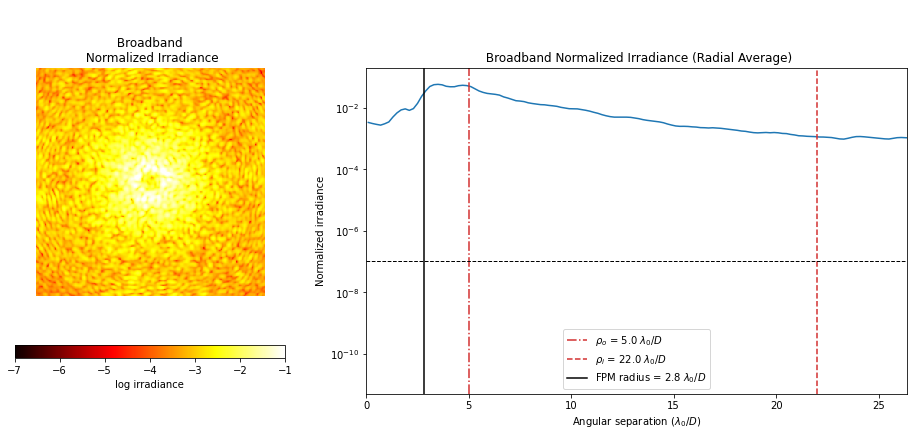

In [365]:
plt.figure(figsize=(16,6))
gs = gridspec.GridSpec(1, 2, width_ratios=[1, 2]) 
plt.subplot(gs[0])
plt.title('\n\n Broadband \n Normalized Irradiance', fontsize=12)
imshow_field(np.log10(occ_psf_ab / max(unocc_psf_ab)), vmin=-contrast - 0, vmax=-contrast + 6, cmap='hot')
cbar = plt.colorbar(orientation='horizontal')
cbar.set_label('log irradiance')
plt.axis('off')
#plt.xlabel('Angular coordinate ($\lambda_0/D$)', fontsize=14)
#plt.ylabel('Angular coordinate ($\lambda_0/D$)', fontsize=14)
plt.tick_params(axis='both', labelsize=8)
plt.subplot(gs[1])
plt.title('\n Broadband Normalized Irradiance (Radial Average)')
plt.plot(r, profile)
iwa_line = plt.axvline(iwa, color=colors.red, linestyle = '-.')
owa_line = plt.axvline(owa, color=colors.red, linestyle = '--')
radius_line = plt.axvline(radius_fpm, color='k')
plt.axhline(10 ** (-contrast), xmin=0, xmax=owa * 1.2, linewidth=1, color='k', linestyle='--')
plt.legend([iwa_line, owa_line, radius_line],
               [r'$\rho_o$ = '+str(float(iwa))+r' $\lambda_0/D$', r'$\rho_i$ = '+str(float(owa))+r' $\lambda_0/D$',
                'FPM radius = '+str(float(radius_fpm))+r' $\lambda_0/D$'])


plt.yscale('log')
plt.xlim(0, owa * 1.2)
plt.ylim(5e-12, 2e-1)
plt.ylabel('Normalized irradiance')
plt.xlabel(r'Angular separation ($\lambda_0/D$)')
plt.savefig('plots/bb_gpi_psf_with_aberration.png', dpi=300, bbox_inches='tight')

### Monochromatic with no aberration

In [277]:
iwa, owa, contrast, radius_fpm = parameters['image']['iwa'], parameters['image']['owa'], parameters['image']['contrast'], parameters['focal_plane_mask']['radius']

coro = LyotCoronagraph(pupil.grid, focal_plane_mask, lyot_stop)
focal_grid = make_focal_grid(8, owa * 1.2)                       
prop = FraunhoferPropagator(pupil.grid, focal_grid)               
wf = Wavefront(pupil * apodizer)
img = prop(coro(wf)).intensity
img_ref = prop(Wavefront(apodizer * lyot_stop)).intensity
r, profile, std_profile, n_profile = radial_profile(img / max(img_ref), 0.2)

Text(0.5, 0, 'Angular separation ($\\lambda_0/D$)')

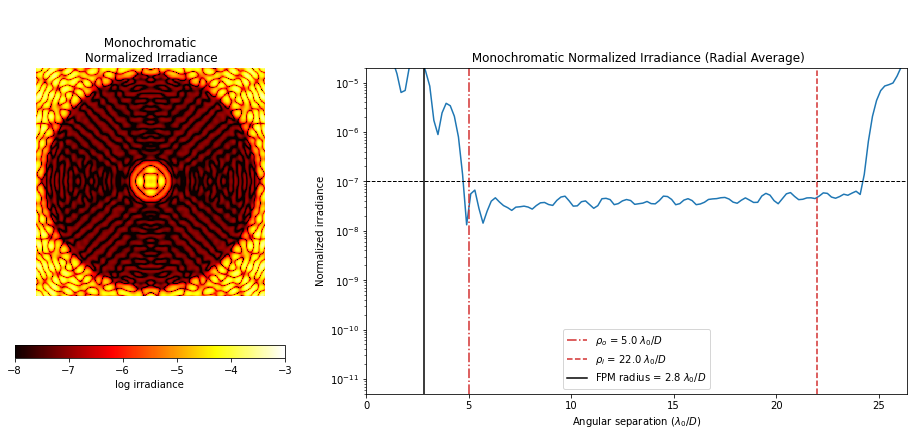

In [12]:
plt.figure(figsize=(16,6))
gs = gridspec.GridSpec(1, 2, width_ratios=[1, 2]) 
plt.subplot(gs[0])
plt.title('\n\n Monochromatic \n Normalized Irradiance', fontsize=12)
imshow_field(np.log10(img / max(img_ref)), vmin=-contrast - 1, vmax=-contrast + 4, cmap='hot')
cbar = plt.colorbar(orientation='horizontal')
cbar.set_label('log irradiance')
plt.axis('off')
#plt.xlabel('Angular coordinate ($\lambda_0/D$)', fontsize=14)
#plt.ylabel('Angular coordinate ($\lambda_0/D$)', fontsize=14)
plt.tick_params(axis='both', labelsize=8)
plt.subplot(gs[1])
plt.title('\n Monochromatic Normalized Irradiance (Radial Average)')
plt.plot(r, profile)
iwa_line = plt.axvline(iwa, color=colors.red, linestyle = '-.')
owa_line = plt.axvline(owa, color=colors.red, linestyle = '--')
radius_line = plt.axvline(radius_fpm, color='k')
plt.axhline(10 ** (-contrast), xmin=0, xmax=owa * 1.2, linewidth=1, color='k', linestyle='--')
plt.legend([iwa_line, owa_line, radius_line],
               [r'$\rho_o$ = '+str(float(iwa))+r' $\lambda_0/D$', r'$\rho_i$ = '+str(float(owa))+r' $\lambda_0/D$',
                'FPM radius = '+str(float(radius_fpm))+r' $\lambda_0/D$'])


plt.yscale('log')
plt.xlim(0, owa * 1.2)
plt.ylim(5e-12, 2e-5)
plt.ylabel('Normalized irradiance')
plt.xlabel(r'Angular separation ($\lambda_0/D$)')

### gpi_aplc_2_test_N0300_telserv3

In [1]:
# 1) So these plots are done using a single wavelength. Rerun the analysis for broadband (a range of wavelengths).
# 2) Then rerun the analysis with a wavefront error introduced (code from Laurent).
# 3) Then do both, broadband and with wavefront error. 

Text(0.5, 0, 'Angular separation ($\\lambda_0/D$)')

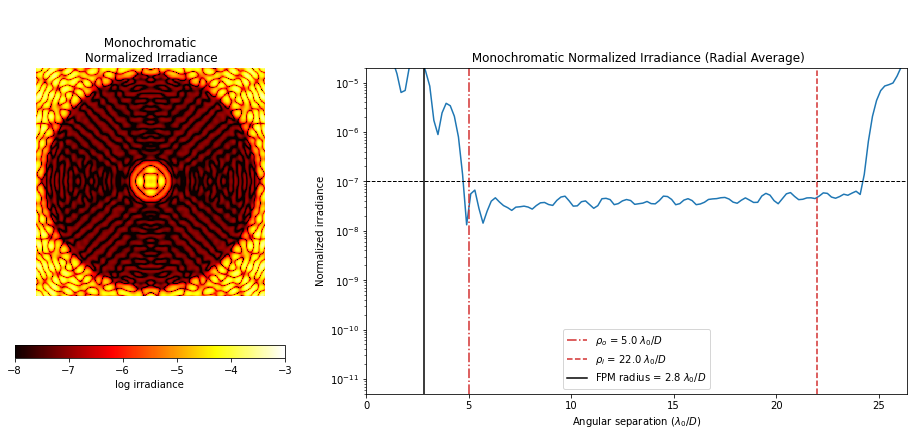

In [11]:
plt.figure(figsize=(16,6))
gs = gridspec.GridSpec(1, 2, width_ratios=[1, 2]) 
plt.subplot(gs[0])
plt.title('\n\n Monochromatic \n Normalized Irradiance', fontsize=12)
imshow_field(np.log10(img / max(img_ref)), vmin=-contrast - 1, vmax=-contrast + 4, cmap='hot')
cbar = plt.colorbar(orientation='horizontal')
cbar.set_label('log irradiance')
plt.axis('off')
#plt.xlabel('Angular coordinate ($\lambda_0/D$)', fontsize=14)
#plt.ylabel('Angular coordinate ($\lambda_0/D$)', fontsize=14)
plt.tick_params(axis='both', labelsize=8)
plt.subplot(gs[1])
plt.title('\n Monochromatic Normalized Irradiance (Radial Average)')
plt.plot(r, profile)
iwa_line = plt.axvline(iwa, color=colors.red, linestyle = '-.')
owa_line = plt.axvline(owa, color=colors.red, linestyle = '--')
radius_line = plt.axvline(radius_fpm, color='k')
plt.axhline(10 ** (-contrast), xmin=0, xmax=owa * 1.2, linewidth=1, color='k', linestyle='--')
plt.legend([iwa_line, owa_line, radius_line],
               [r'$\rho_o$ = '+str(float(iwa))+r' $\lambda_0/D$', r'$\rho_i$ = '+str(float(owa))+r' $\lambda_0/D$',
                'FPM radius = '+str(float(radius_fpm))+r' $\lambda_0/D$'])


plt.yscale('log')
plt.xlim(0, owa * 1.2)
plt.ylim(5e-12, 2e-5)
plt.ylabel('Normalized irradiance')
plt.xlabel(r'Angular separation ($\lambda_0/D$)')

------------
# 3.0  Lyot Robustness

Here we introduce robust (tolerant to Lyot stop misalignment) solution to compare the difference in PSFs when Lyot stop misalignment is introduced.

In [43]:
robust_survey_name = 'gpi_fpmK1_robust_5px_5ls_N0512_telserv3'
robust_solution_filename = '0_GPI_N512_FPM347M0512_IWA0300_OWA02200_C8_BW20_Nlam3_LS_ID04_ov_ODp01__ls_truts_no_tab.fits'
robust_solution = path+'/Surveys/'+robust_survey_name+'/solutions/'+robust_solution_filename #solution path

robust_pupil, robust_apodizer, robust_focal_plane_mask, robust_lyot_stops, robust_parameters, robust_file_organization = create_coronagraph(robust_solution)
robust_lyot_stop = robust_lyot_stops[0]

In [62]:
pupil_grid = hcipy.make_pupil_grid(300)
focal_grid = hcipy.make_focal_grid(q=5, num_airy=1024/10)

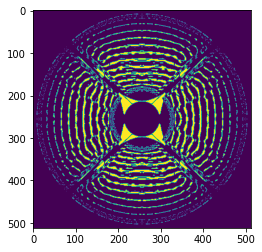

In [72]:
plt.imshow(robust_apodizer.reshape(512, 512))

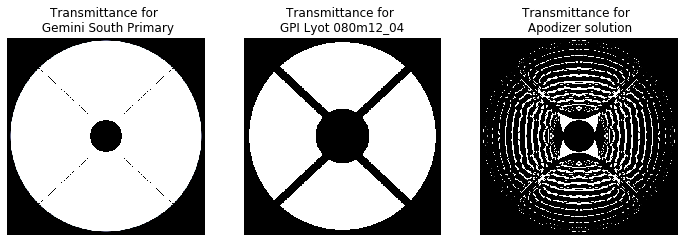

In [11]:
hcipy.FraunhoferPropagator(pupil_grid, focal_grid)
plt.figure(figsize=(12,6))
plt.subplot(1,3,1)
plt.title('Transmittance for \n Gemini South Primary')
plt.axis('off')
imshow_field(robust_pupil, cmap='bone')
plt.subplot(1,3,2)
plt.title('Transmittance for \n'+lyot_name)
plt.axis('off')
imshow_field(robust_lyot_stop, cmap='gray')
plt.subplot(1,3,3)
plt.title('Transmittance for \n Apodizer solution')
plt.axis('off')
imshow_field(robust_apodizer, cmap='gray')

### gpi_fpmK1_robust_5px_5ls_N0512_telserv3

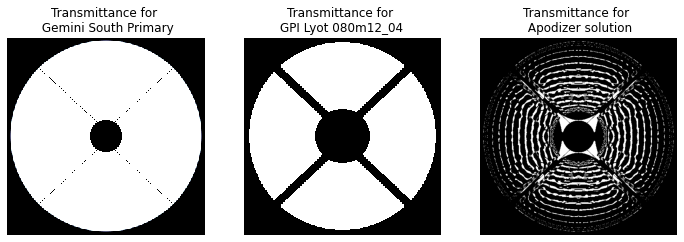

In [74]:
hcipy.FraunhoferPropagator(pupil_grid, focal_grid)
plt.figure(figsize=(12,6))
plt.subplot(1,3,1)
plt.title('Transmittance for \n Gemini South Primary')
plt.axis('off')
imshow_field(robust_pupil, cmap='bone')
plt.subplot(1,3,2)
plt.title('Transmittance for \n'+lyot_name)
plt.axis('off')
imshow_field(robust_lyot_stop, cmap='gray')
plt.subplot(1,3,3)
plt.title('Transmittance for \n Apodizer solution')
plt.axis('off')
plt.imshow(robust_apodizer.reshape(512,512), cmap='gray')

Text(0.5, 0, 'Angular separation ($\\lambda_0/D$)')

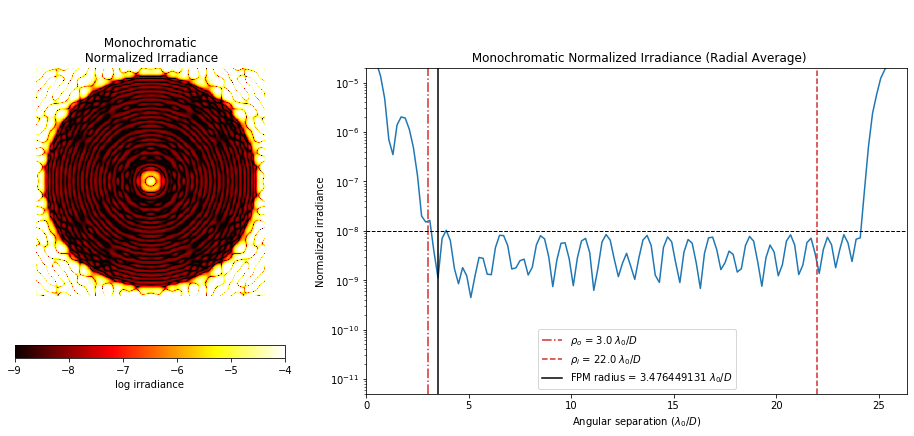

In [12]:
robust_iwa, robust_owa, robust_contrast, robust_radius_fpm = robust_parameters['image']['iwa'], robust_parameters['image']['owa'], robust_parameters['image']['contrast'], robust_parameters['focal_plane_mask']['radius']

robust_coro = LyotCoronagraph(robust_pupil.grid, robust_focal_plane_mask, robust_lyot_stop)
robust_focal_grid = make_focal_grid(8, robust_owa * 1.2)                       
robust_prop = FraunhoferPropagator(robust_pupil.grid, robust_focal_grid)               
robust_wf = Wavefront(robust_pupil * robust_apodizer)
robust_img = robust_prop(robust_coro(robust_wf)).intensity
robust_img_ref = robust_prop(Wavefront(robust_apodizer * robust_lyot_stop)).intensity
robust_r, robust_profile, robust_std_profile, robust_n_profile = radial_profile(robust_img / max(robust_img_ref), 0.2)

plt.figure(figsize=(16,6))
robust_gs = gridspec.GridSpec(1, 2, width_ratios=[1, 2]) 
plt.subplot(robust_gs[0])
plt.title('\n\n Monochromatic \n Normalized Irradiance', fontsize=12)
imshow_field(np.log10(robust_img / max(robust_img_ref)), vmin=-contrast - 1, vmax=-contrast + 4, cmap='hot')
cbar = plt.colorbar(orientation='horizontal')
cbar.set_label('log irradiance')
plt.axis('off')
#plt.xlabel('Angular coordinate ($\lambda_0/D$)', fontsize=14)
#plt.ylabel('Angular coordinate ($\lambda_0/D$)', fontsize=14)
plt.tick_params(axis='both', labelsize=8)
plt.subplot(gs[1])
plt.title('\n Monochromatic Normalized Irradiance (Radial Average)')
plt.plot(robust_r, robust_profile)
robust_iwa_line = plt.axvline(robust_iwa, color=colors.red, linestyle = '-.')
robust_owa_line = plt.axvline(robust_owa, color=colors.red, linestyle = '--')
robust_radius_line = plt.axvline(robust_radius_fpm, color='k')
plt.axhline(10 ** (-robust_contrast), xmin=0, xmax=robust_owa * 1.2, linewidth=1, color='k', linestyle='--')
plt.legend([robust_iwa_line, robust_owa_line, robust_radius_line],
               [r'$\rho_o$ = '+str(float(robust_iwa))+r' $\lambda_0/D$', r'$\rho_i$ = '+str(float(robust_owa))+r' $\lambda_0/D$',
                'FPM radius = '+str(float(robust_radius_fpm))+r' $\lambda_0/D$'])


plt.yscale('log')
plt.xlim(0, robust_owa * 1.2)
plt.ylim(5e-12, 2e-5)
plt.ylabel('Normalized irradiance')
plt.xlabel(r'Angular separation ($\lambda_0/D$)')

In [13]:
rob_ls_align_tol = robust_parameters['lyot_stop']['alignment_tolerance']

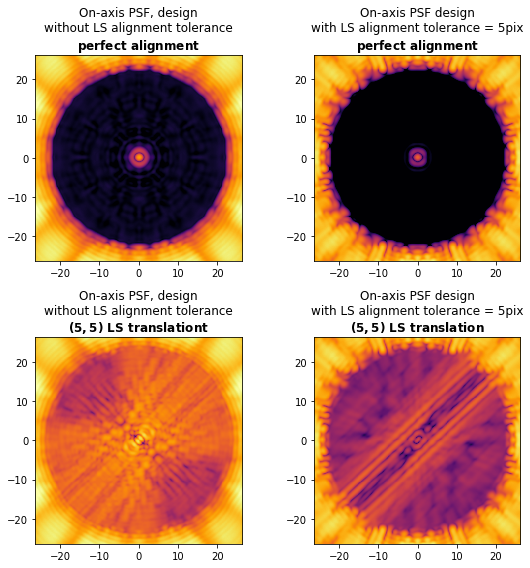

In [14]:
wavelengths = np.linspace(-bandwidth / 2, bandwidth / 2, 11) + 1
dx = 5 # x translation in pixels
dy = 5 # y translation in pixels

focal_grid = make_focal_grid(8, owa * 1.2)
robust_focal_grid = make_focal_grid(8, robust_owa * 1.2)

prop = FraunhoferPropagator(pupil.grid, focal_grid)
robust_prop = FraunhoferPropagator(robust_pupil.grid, robust_focal_grid)

aligned_lyot_stop = np.roll(np.roll(lyot_stop.shaped, 0, 1), 0, 0).ravel()
robust_aligned_lyot_stop = np.roll(np.roll(robust_lyot_stop.shaped, 0, 1), 0, 0).ravel()

shifted_lyot_stop = np.roll(np.roll(lyot_stop.shaped, dx, 1), dy, 0).ravel()
robust_shifted_lyot_stop = np.roll(np.roll(robust_lyot_stop.shaped, dx, 1), dy, 0).ravel()

aligned_coro = LyotCoronagraph(pupil.grid, focal_plane_mask, aligned_lyot_stop)
robust_aligned_coro = LyotCoronagraph(robust_pupil.grid, robust_focal_plane_mask, robust_aligned_lyot_stop)

shifted_coro = LyotCoronagraph(pupil.grid, focal_plane_mask, shifted_lyot_stop)
robust_shifted_coro = LyotCoronagraph(robust_pupil.grid, robust_focal_plane_mask, robust_shifted_lyot_stop)

on_img = 0
off_img = 0
on_robust_img = 0 
off_robust_img = 0 
on_img_ref = 0
off_img_ref = 0
on_robust_img_ref = 0 
off_robust_img_ref = 0 

for wl in wavelengths:
    wf = Wavefront(pupil * apodizer, wl)
    robust_wf = Wavefront(robust_pupil * robust_apodizer, wl)
    
    on_img += prop(aligned_coro(wf)).intensity
    off_img += prop(shifted_coro(wf)).intensity
    
    on_robust_img += robust_prop(robust_aligned_coro(robust_wf)).intensity
    off_robust_img += robust_prop(robust_shifted_coro(robust_wf)).intensity
    
    on_img_ref += prop(Wavefront(pupil * aligned_lyot_stop)).intensity
    off_img_ref += prop(Wavefront(pupil * shifted_lyot_stop)).intensity
    
    on_robust_img_ref += robust_prop(Wavefront(robust_pupil * robust_aligned_lyot_stop)).intensity
    off_robust_img_ref += robust_prop(Wavefront(robust_pupil * robust_shifted_lyot_stop)).intensity
    

plt.figure(figsize=(8,8))
plt.subplot(2,2,1)
plt.title('On-axis PSF, design\nwithout LS alignment tolerance\n'+ r'$\bf{perfect \ alignment}$')
imshow_field(np.log10(on_img / max(on_img_ref)), vmin=-contrast - 1, vmax=-contrast + 4, cmap='inferno')
plt.subplot(2,2,2)
plt.title('On-axis PSF design\nwith LS alignment tolerance = '+str(rob_ls_align_tol)+'pix\n'+r'$\bf{perfect \ alignment}$')
imshow_field(np.log10(on_robust_img / max(on_robust_img_ref)), vmin=-robust_contrast - 1, vmax=-robust_contrast + 4, cmap='inferno')
plt.subplot(2,2,3)
plt.title('On-axis PSF, design\nwithout LS alignment tolerance\n'+ r'$\bf{('+str(dx)+','+str(dy)+') \ LS \ translationt}$')
imshow_field(np.log10(off_img / max(off_img_ref)), vmin=-contrast - 1, vmax=-contrast + 4, cmap='inferno')
plt.subplot(2,2,4)
plt.title('On-axis PSF design\nwith LS alignment tolerance = '+str(rob_ls_align_tol)+'pix\n'+ r'$\bf{('+str(dx)+','+str(dy)+') \ LS \ translation}$')
imshow_field(np.log10(off_robust_img / max(off_robust_img_ref)), vmin=- robust_contrast - 1, vmax=-robust_contrast + 4, cmap='inferno')
plt.tight_layout()

Text(0.5, 0, 'Angular separation ($\\lambda_0/D$)')

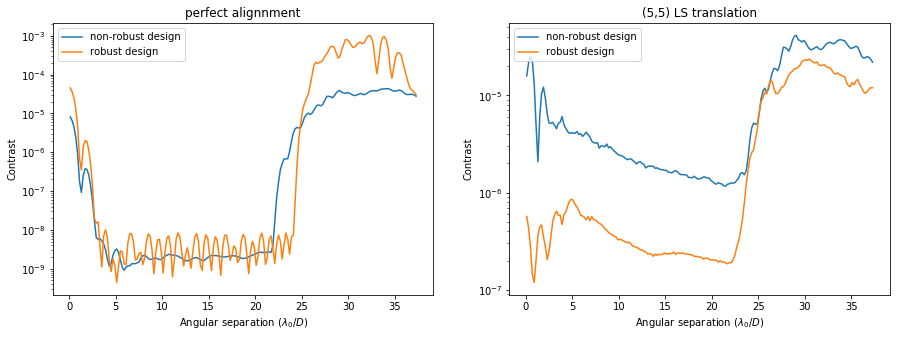

In [15]:
r, profile, std_profile, n_profile = radial_profile(on_img / max(on_img_ref), 0.2)
robust_r, robust_profile, robust_std_profile, robust_n_profile = radial_profile(robust_img / max(robust_img_ref), 0.2)
off_r, off_profile, off_std_profile, off_n_profile = radial_profile(off_img / max(off_img_ref), 0.2)
off_robust_r, off_robust_profile, off_robust_std_profile, off_robust_n_profile = radial_profile(off_robust_img / max(off_robust_img_ref), 0.2)

plt.figure(figsize=(15,5))
#plt.title('\n Monochromatic Normalized Irradiance (Radial Average)')
plt.subplot(1,2,1)
plt.title('perfect alignnment')
plt.plot(r, profile)
plt.plot(robust_r, robust_profile)
plt.legend(['non-robust design','robust design','red'], loc='upper left')
plt.yscale('log')
#plt.xlim(0, owa * 1.2)
#plt.ylim(5e-12, 2e-5)
plt.ylabel('Contrast')
plt.xlabel(r'Angular separation ($\lambda_0/D$)')

plt.subplot(1,2,2)
plt.title('('+str(dx)+','+str(dy)+') LS translation')
plt.plot(off_r, off_profile)
plt.plot(off_robust_r, off_robust_profile)
plt.legend(['non-robust design','robust design','red'], loc='upper left')
plt.yscale('log')
#plt.xlim(0, owa * 1.2)
#plt.ylim(5e-12, 2e-5)
plt.ylabel('Contrast')
plt.xlabel(r'Angular separation ($\lambda_0/D$)')

In [16]:
dx = 5 # x translation in pixels
dy = 5 # y translation in pixels
shifted_lyot_stop = np.roll(np.roll(lyot_stop.shaped, dx, 1), dy, 0).ravel()
coro = LyotCoronagraph(pupil.grid, focal_plane_mask, shifted_lyot_stop)

Text(0.5, 1.0, 'Non-robust solution off-axis PSFs \n')

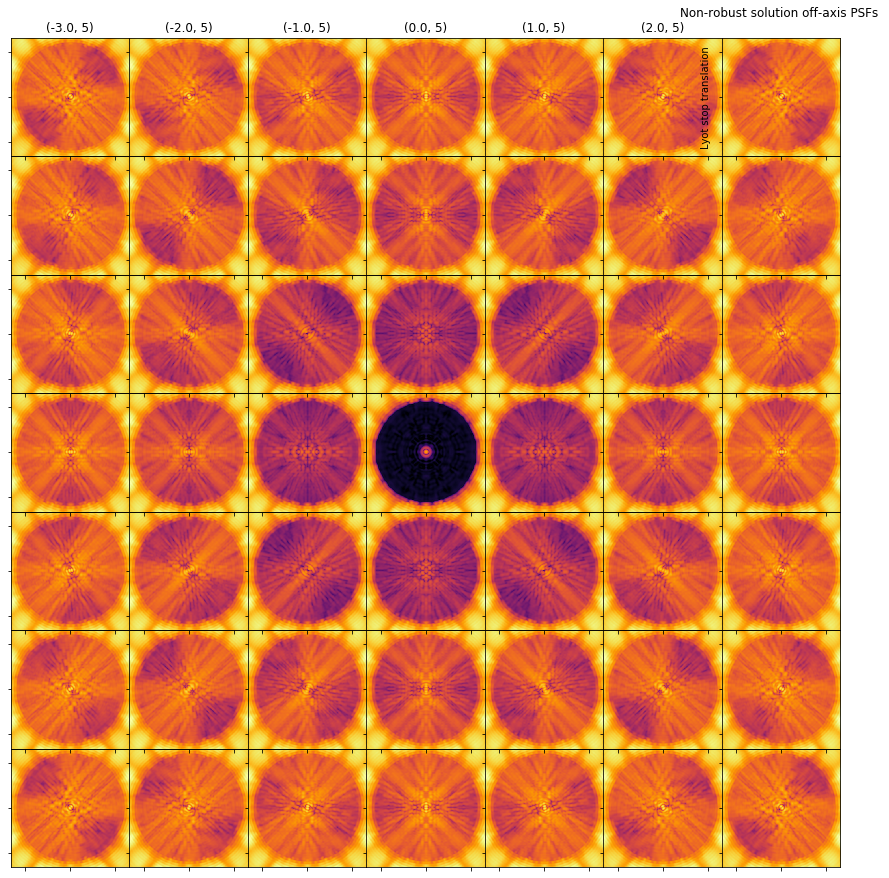

In [17]:
ls_alignment_tolerance = 5 #pixels
dxs = np.array(range(-ls_alignment_tolerance-1,+ls_alignment_tolerance+1+1,2))

dither_grid = CartesianGrid(SeparatedCoords((dxs, dxs)))

plt.figure(figsize=(12, 12))
for i, (dx, dy) in enumerate(dither_grid.points):
    shifted_lyot_stop = np.roll(np.roll(lyot_stop.shaped, dx, 1), dy, 0).ravel()
    coro = LyotCoronagraph(pupil.grid, focal_plane_mask, shifted_lyot_stop)

    img = 0
    img_ref = 0
    
    for wl in wavelengths:
        wf = Wavefront(pupil * apodizer, wl)
        img += prop(coro(wf)).intensity
        img_ref += prop(Wavefront(pupil * apodizer * lyot_stop)).intensity
        
    x = i % len(dxs)
    y = i // len(dxs)

    plt.subplot(len(dxs), len(dxs), x + (len(dxs) - y - 1) * len(dxs) + 1)
    plt.title('('+str(dx/2)+', '+str(dy-1)+')')
    imshow_field(np.log10(img / max(img_ref)), vmin=-contrast - 1, vmax=-contrast + 4, cmap='inferno')

    frame1 = plt.gca()
    frame1.axes.xaxis.set_ticklabels([])
    frame1.axes.yaxis.set_ticklabels([])

plt.subplots_adjust(top=0.98, bottom=0.02, left=0.02, right=0.98, wspace=0, hspace=0)
plt.ylabel('Lyot stop translation')
plt.title('Non-robust solution off-axis PSFs \n')

Text(0.5, 1.0, 'Non-robust solution off-axis PSFs \n')

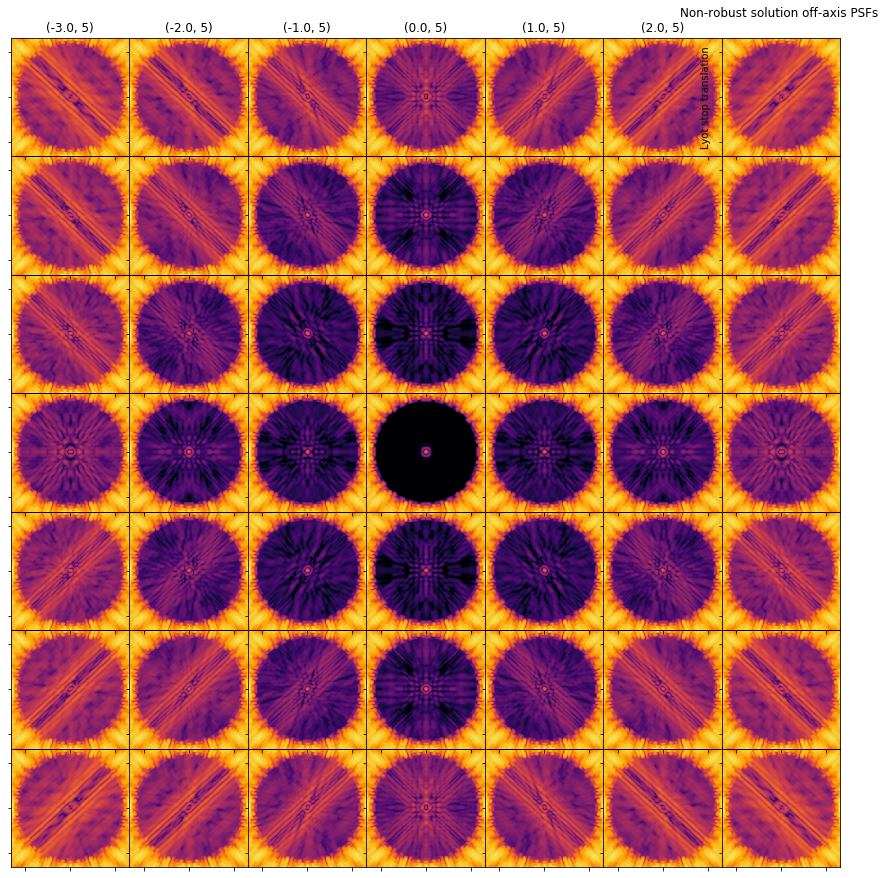

In [18]:
robust_ls_alignment_tolerance = 5 #pixels
dxs = np.array(range(-robust_ls_alignment_tolerance-1,+robust_ls_alignment_tolerance+1+1,2))

dither_grid = CartesianGrid(SeparatedCoords((dxs, dxs)))

plt.figure(figsize=(12, 12))
for i, (dx, dy) in enumerate(dither_grid.points):
    robust_shifted_lyot_stop = np.roll(np.roll(robust_lyot_stop.shaped, dx, 1), dy, 0).ravel()
    robust_coro = LyotCoronagraph(robust_pupil.grid, robust_focal_plane_mask, robust_shifted_lyot_stop)

    robust_img = 0
    robust_img_ref = 0
    
    for wl in wavelengths:
        wf = Wavefront(robust_pupil * robust_apodizer, wl)
        robust_img += robust_prop(robust_coro(wf)).intensity
        robust_img_ref += robust_prop(Wavefront(robust_pupil * robust_lyot_stop)).intensity
        
    x = i % len(dxs)
    y = i // len(dxs)

    plt.subplot(len(dxs), len(dxs), x + (len(dxs) - y - 1) * len(dxs) + 1)
    plt.title('('+str(dx/2)+', '+str(dy-1)+')')
    imshow_field(np.log10(robust_img / max(robust_img_ref)), vmin=-robust_contrast - 1, vmax=-robust_contrast + 4, cmap='inferno')

    frame1 = plt.gca()
    frame1.axes.xaxis.set_ticklabels([])
    frame1.axes.yaxis.set_ticklabels([])

plt.subplots_adjust(top=0.98, bottom=0.02, left=0.02, right=0.98, wspace=0, hspace=0)
plt.ylabel('Lyot stop translation')
plt.title('Non-robust solution off-axis PSFs \n')